# Task Description

Build a machine learning model to predict customer churn for a subscription-based service.
Customer churn, and the rate at which customers leave a service, is a critical metric for
business success. The goal of this assignment is to develop a predictive model that can identify
customers at risk of churning based on historical data.

In [15]:
import re
import pandas as pd
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from ydata_profiling import ProfileReport

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [16]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import recall_score, confusion_matrix, precision_score, f1_score, accuracy_score, classification_report

In [117]:
df = pd.read_csv('train_data_assignment.csv')

# Exploratory Data Analysis



In [116]:
profile = ProfileReport(df, title='Customer data profile')

In [5]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
df.shape

(5000, 30)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 30 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   5000 non-null   int64  
 1   Age                          5000 non-null   int64  
 2   Address                      5000 non-null   object 
 3   MonthlySpend                 5000 non-null   float64
 4   ContractLength               5000 non-null   int64  
 5   Tenure                       5000 non-null   int64  
 6   Churn                        5000 non-null   int64  
 7   SatisfactionScore            5000 non-null   int64  
 8   SupportTickets               4303 non-null   float64
 9   ProductUsage                 5000 non-null   int64  
 10  MonthlyDiscount              5000 non-null   float64
 11  PaymentMethod                5000 non-null   object 
 12  DeviceType                   5000 non-null   object 
 13  PreferredLoginDevi

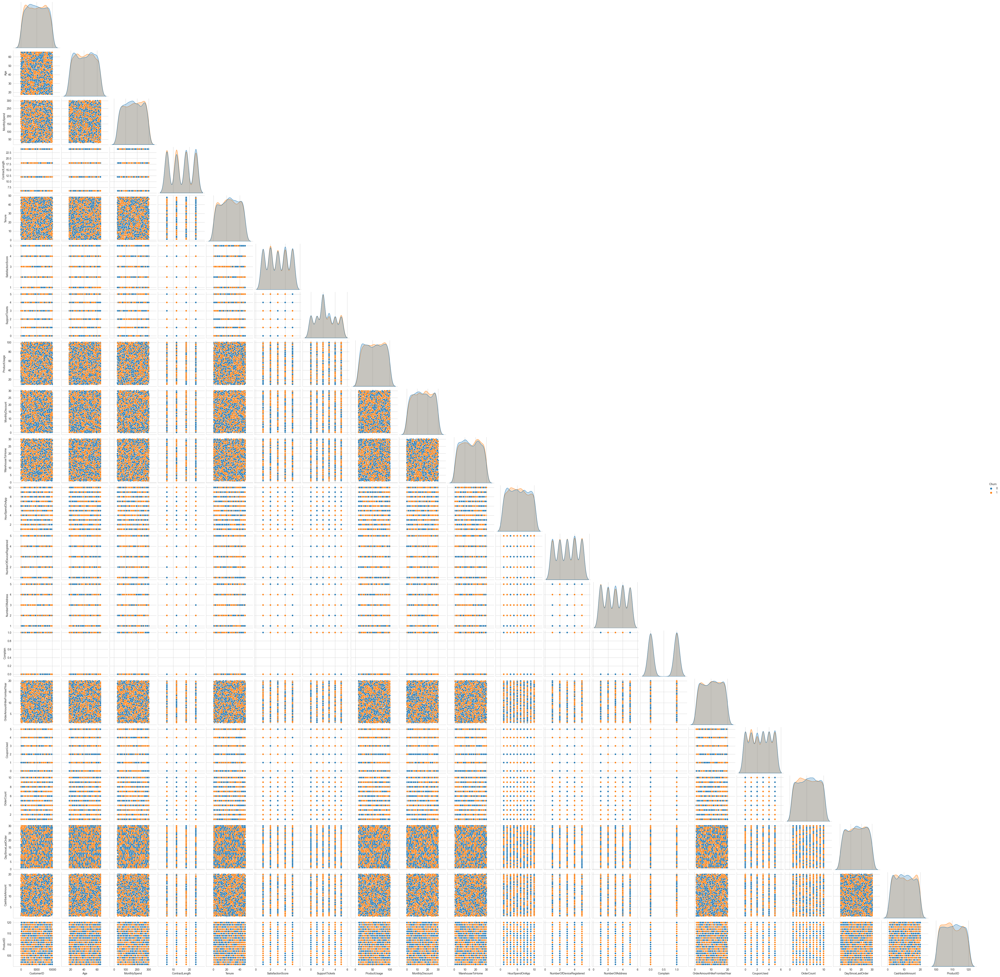

In [228]:
sns.pairplot(df, corner=True, hue='Churn')

In [8]:
df.head()

,CustomerID,Age,Address,MonthlySpend,ContractLength,Tenure,Churn,SatisfactionScore,SupportTickets,ProductUsage,...,PreferedOrderCat,MaritalStatus,NumberOfAddress,Complain,OrderAmountHikeFromlastYear,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount,ProductID
0,7305,54,"530 Daniel Rapid\nNelsonville, KS 35079",212.85,12,23,0,3,NaN,29,...,Clothing,Single,4,1,12.80,5,4,15,16.69,119
1,9074,53,"2574 Louis Forest\nNew Carolynberg, CA 94685",252.88,24,4,0,1,0.0,70,...,Books,Single,4,1,3.29,4,9,11,18.06,112
2,8544,40,"088 Richardson Islands\nDelacruzberg, WV 87932",215.38,12,44,0,2,NaN,21,...,Clothing,Married,4,0,9.29,5,9,22,11.69,112
3,1901,40,"83537 Sutton Ferry Suite 513\nThomasfurt, AZ 9...",165.37,18,7,1,2,1.0,90,...,Electronics,Single,4,1,8.08,2,1,8,2.46,109
4,8634,33,"6134 Wall Trafficway\nNew Christopherport, NE ...",105.05,6,36,1,1,4.0,12,...,Books,Married,3,1,14.76,1,3,1,10.22,104


In [19]:
df.MaritalStatus.value_counts()

MaritalStatus
Married    2553
Single     2447
Name: count, dtype: int64

In [9]:
df.columns.values

array(['CustomerID', 'Age', 'Address', 'MonthlySpend', 'ContractLength',
       'Tenure', 'Churn', 'SatisfactionScore', 'SupportTickets',
       'ProductUsage', 'MonthlyDiscount', 'PaymentMethod', 'DeviceType',
       'PreferredLoginDevice', 'CityTier', 'WarehouseToHome',
       'PreferredPaymentMode', 'Gender', 'HourSpendOnApp',
       'NumberOfDeviceRegistered', 'PreferedOrderCat', 'MaritalStatus',
       'NumberOfAddress', 'Complain', 'OrderAmountHikeFromlastYear',
       'CouponUsed', 'OrderCount', 'DaySinceLastOrder', 'CashbackAmount',
       'ProductID'], dtype=object)

In [85]:
df.PreferedOrderCat.value_counts()

PreferedOrderCat
Books          1279
Clothing       1264
Toys           1257
Electronics    1200
Name: count, dtype: int64

In [341]:
df.Address.value_counts()

Address
530 Daniel Rapid\nNelsonville, KS 35079                        1
175 Nelson Freeway\nLake Kimberlystad, TX 94527                1
0400 Andrea Lock Suite 528\nNorth Deborahton, AL 78248         1
2841 Johnston Branch Suite 857\nLake Sarahborough, NC 97593    1
7987 Dawn Glens Apt. 962\nNew Steven, FM 19512                 1
                                                              ..
277 Randy Route Suite 609\nYangburgh, KY 06535                 1
USNS Coleman\nFPO AE 14549                                     1
Unit 3912 Box 6291\nDPO AA 33250                               1
1233 Moon Drive\nNew Stephanieton, NC 26826                    1
780 Morgan Islands\nLunaburgh, CO 71955                        1
Name: count, Length: 5000, dtype: int64

In [26]:
df.CustomerID.value_counts().values.mean()

1.273560876209883

In [31]:
df['City'] = df['Address'].apply(lambda x: x.split('\n')[-1].rsplit(', ', 1)[0])

In [35]:
df.City.value_counts()

City
Lake Christopher    7
Lake Michael        6
Port Robert         5
Port David          5
West Michael        5
                   ..
FPO AP 31775        1
Kaylaborough        1
FPO AA 33420        1
Port Christopher    1
Lunaburgh           1
Name: count, Length: 4404, dtype: int64

## Dealing with missing data

<Axes: >

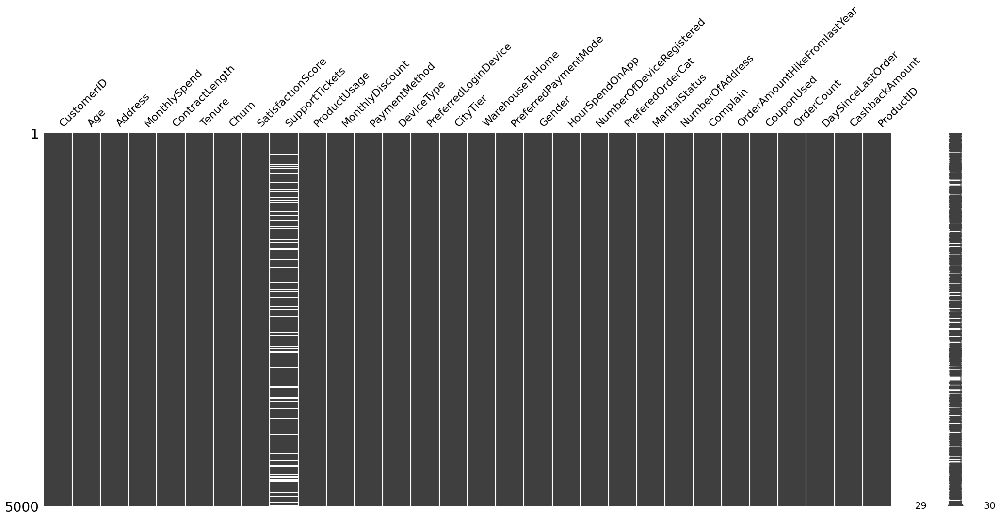

In [10]:
msno.matrix(df)

From the plot below we can tell that missing values in the support tickets have strong correlation with `CashbackAmount`

<Axes: >

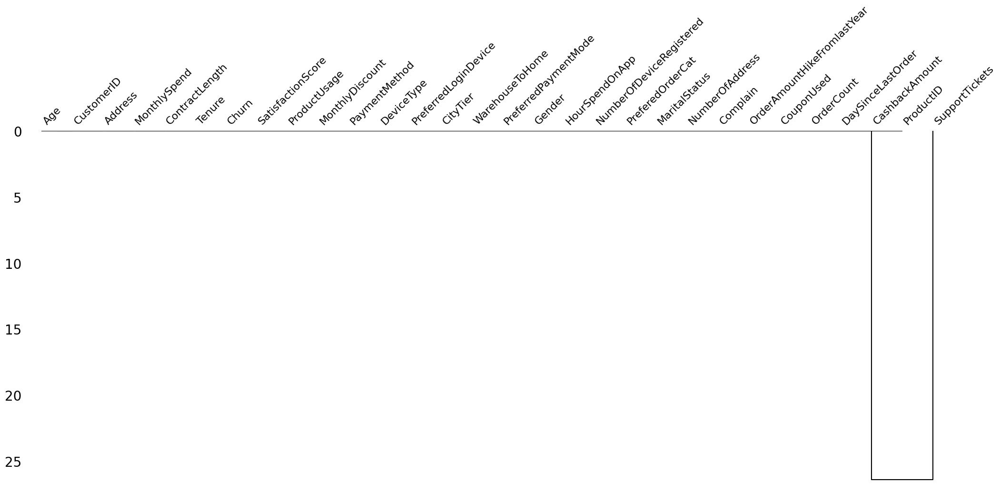

In [11]:
msno.dendrogram(df)

<Axes: >

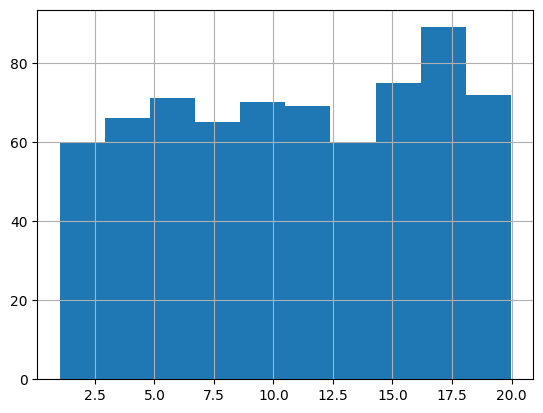

In [12]:
df[df['SupportTickets'].isna()]['CashbackAmount'].hist()

<Axes: >

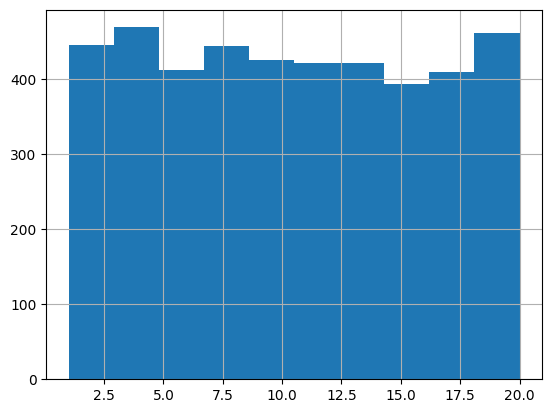

In [13]:
df[df['SupportTickets'].isna() == False]['CashbackAmount'].hist()

<Axes: >

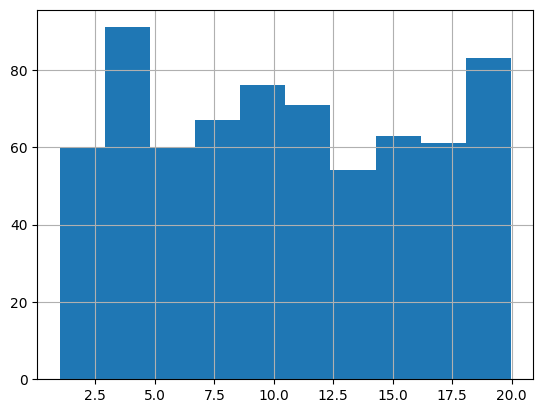

In [14]:
df[df['SupportTickets'] == 4.0]['CashbackAmount'].hist()

<Axes: >

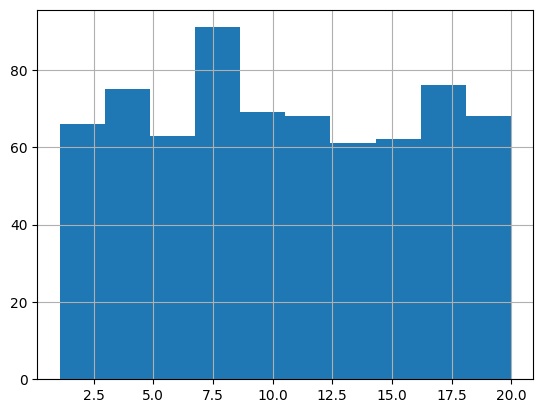

In [15]:
df[df['SupportTickets'] == 1.0]['CashbackAmount'].hist()

Let's see how balanced `SupportTickets` in terms of `Churn`.

In [16]:
df[df['SupportTickets'].isna()]['Churn'].value_counts()

Churn
1    353
0    344
Name: count, dtype: int64

In [17]:
print('The missing values for the SupportTickets columns are more or less equally distributed across Churn column.')
print(f"Missing values is {round((len(df[df['SupportTickets'].isna()]) / len(df) * 100), 2)}%.")

The missing values for the SupportTickets columns are more or less equally distributed across Churn column.
Missing values is 13.94%.


In [18]:
df['SupportTickets'].value_counts()

SupportTickets
3.0    743
0.0    730
2.0    724
5.0    721
1.0    699
4.0    686
Name: count, dtype: int64

The distribution of the `SupportTickets` is not heavily skewed therefore we can replace missing values with the `median`. This method is more robust to outliers.

In [118]:
median_value = df['SupportTickets'].median()
df['SupportTickets'].fillna(median_value, inplace=True)

___
# Data Vizualization

Let's try to vizualize insides.

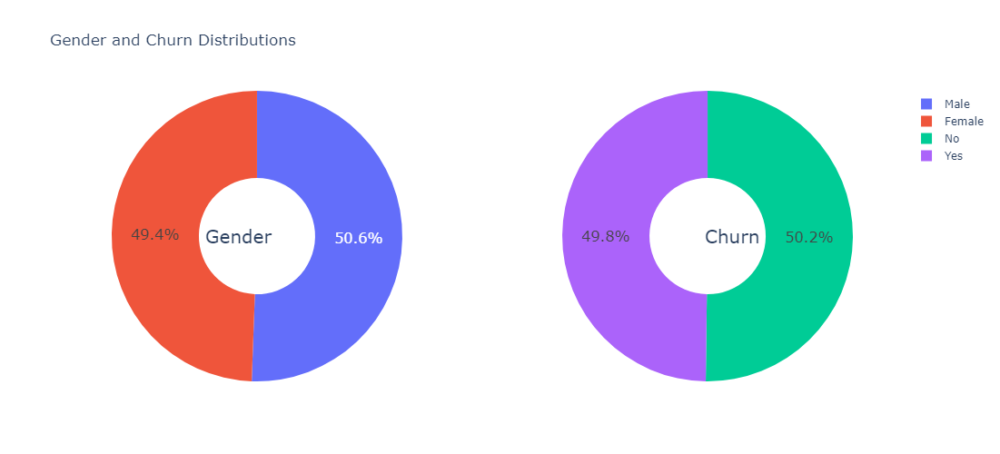

In [14]:
g_labels = ['Male', 'Female']
c_labels = ['No', 'Yes']
# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=g_labels, values=df['Gender'].value_counts(), name="Gender"),
              1, 1)
fig.add_trace(go.Pie(labels=c_labels, values=df['Churn'].value_counts(), name="Churn"),
              1, 2)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name", textfont_size=16)

fig.update_layout(
    title_text="Gender and Churn Distributions",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Gender', x=0.16, y=0.5, font_size=20, showarrow=False),
                 dict(text='Churn', x=0.84, y=0.5, font_size=20, showarrow=False)],
    width =900,
    height=500
)
fig.show()

- There are 50% of male customers
- About a half of customers choose another company

In [21]:
df["Churn"][df["Churn"] == 1].groupby(by=df["Gender"]).count()

Gender
Female    1224
Male      1266
Name: Churn, dtype: int64

From the customers who decided to move with another company there are approximately 50% of males and 50% females.

In [22]:
df["Churn"][df["Churn"] == 0].groupby(by=df["Gender"]).count()

Gender
Female    1247
Male      1263
Name: Churn, dtype: int64

The similar situation we can observe for the customers who decided to stay.

In [23]:
df.select_dtypes(include=['object']).columns

Index(['Address', 'PaymentMethod', 'DeviceType', 'PreferredLoginDevice',
       'CityTier', 'PreferredPaymentMode', 'Gender', 'PreferedOrderCat',
       'MaritalStatus'],
      dtype='object')

In [10]:
def histogram_churn_comparison(df: pd.DataFrame, column: str):
    
    formatted_column = ' '.join(re.findall('[A-Z][^A-Z]*', column))
    fig = px.histogram(df, x="Churn", color=column, barmode="group", title=f"<b>{formatted_column} distribution<b>")
    fig.update_layout(width=700, height=500, bargap=0.1)
    fig.show()

There's no that much difference beween payment mentods among customers who left the company and the one who stayed.

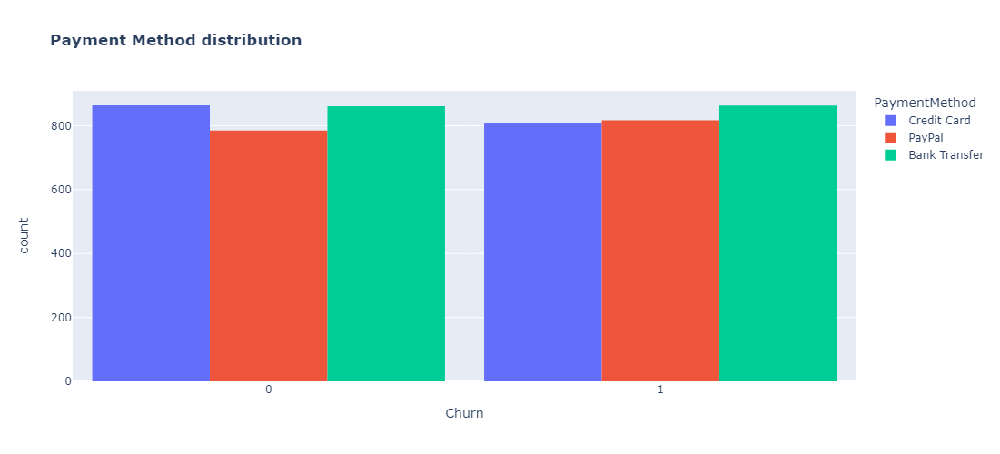

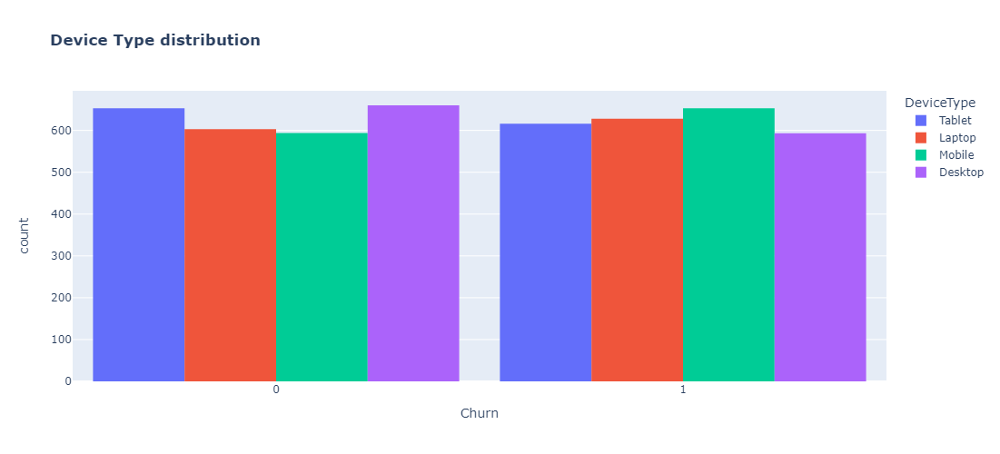

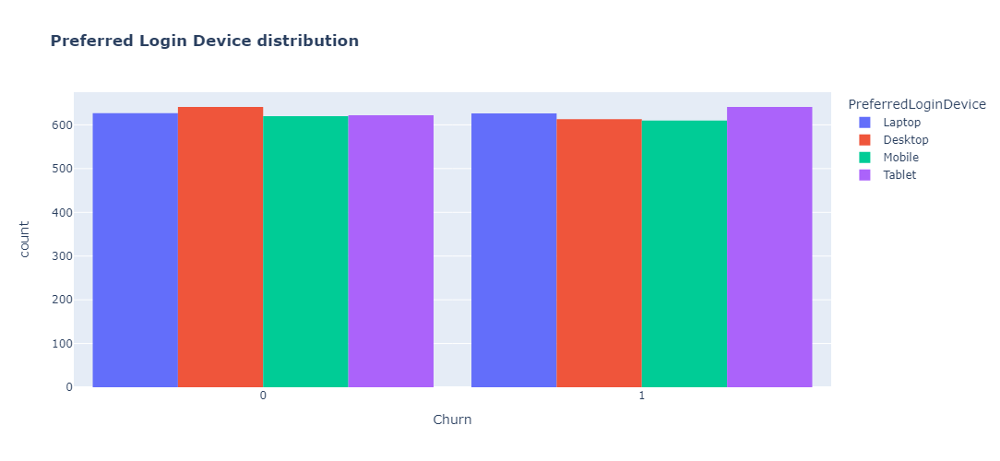

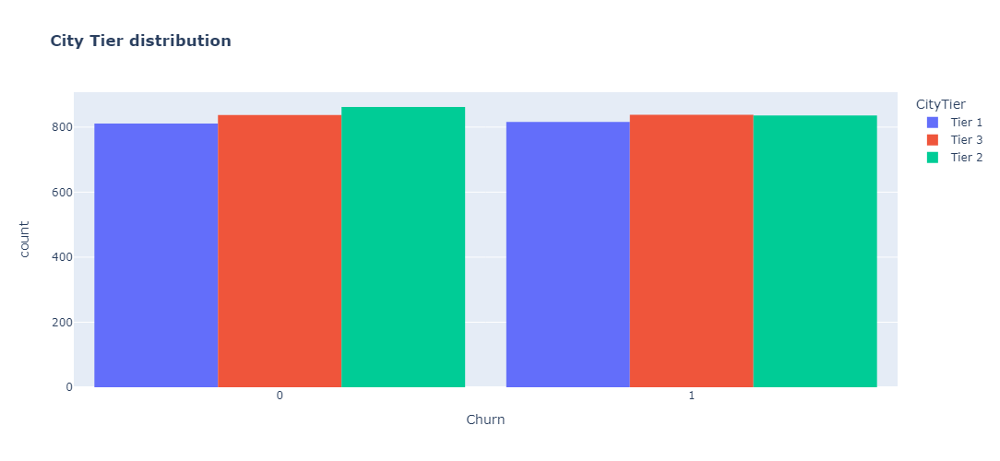

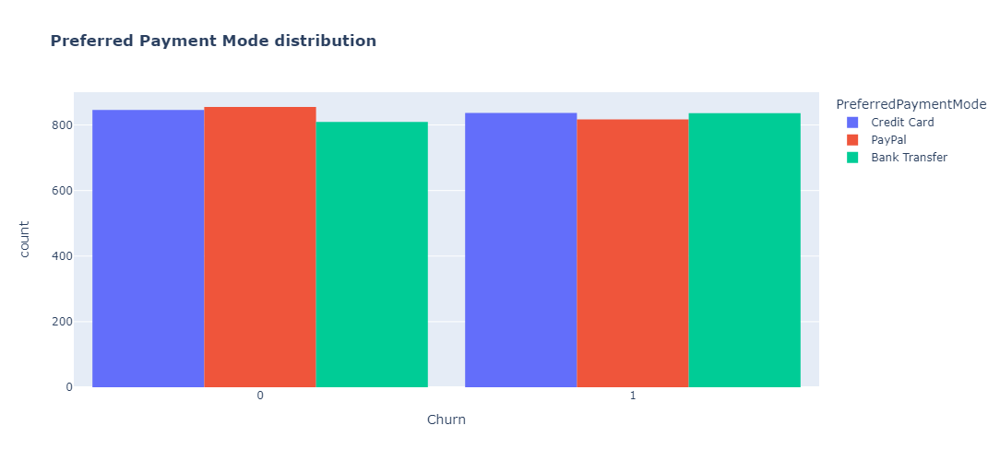

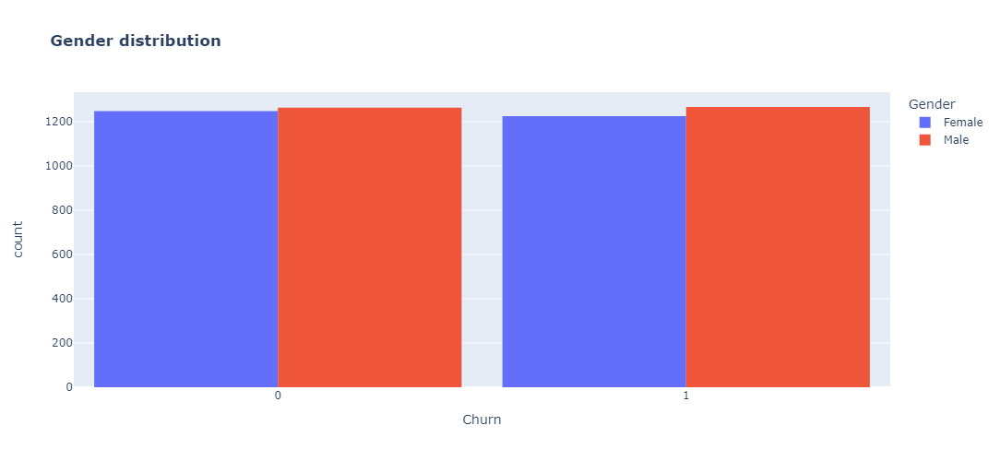

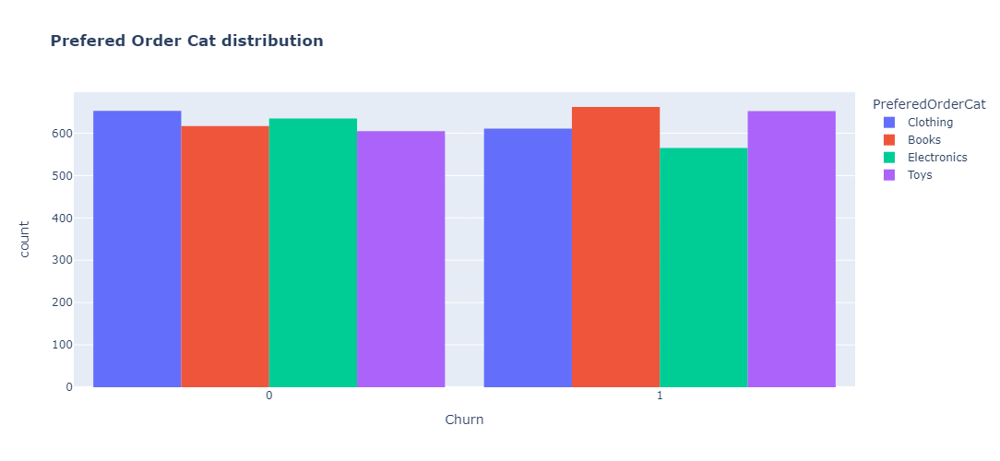

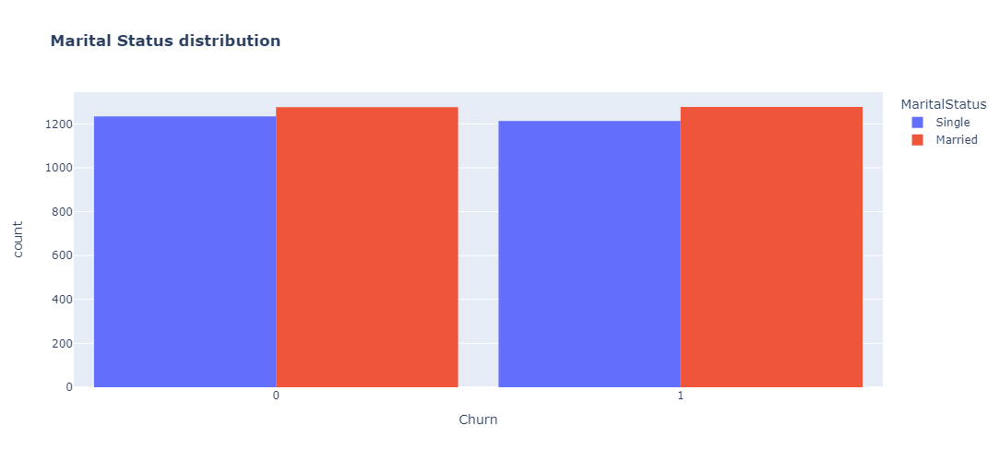

In [11]:
for item in df.drop('Address', axis=1).select_dtypes(include=['object']).columns.tolist():
    
    histogram_churn_comparison(df, item)

For all of the cases above the data looks balanced. Except for the Prefered Order Category, where for those who decided to move with another company the category of electronic is less frequent, clothing and books are more frequent. Which mean that customers which prefere books and clothing category are seems to be more likely to churn.

In [26]:
def kde_churn_plot(df: pd.DataFrame, column: str):
    
    formatted_column = ' '.join(re.findall('[A-Z][^A-Z]*', column))
    
    sns.set_context("paper",font_scale=1.1)
    
    ax = sns.kdeplot(df[column][(df["Churn"] == 0)],
                     color="Red", shade = True);
    
    ax = sns.kdeplot(df[column][(df["Churn"] == 1)],
                     ax=ax, color="Blue", shade= True)
    
    ax.legend(["Not Churn","Churn"], bbox_to_anchor=(1.05, 1), loc='upper left')
    ax.set_ylabel('Density')
    ax.set_xlabel(f'{formatted_column}')
    ax.set_title(f'Distribution of {formatted_column} by churn')
    
    plt.show()

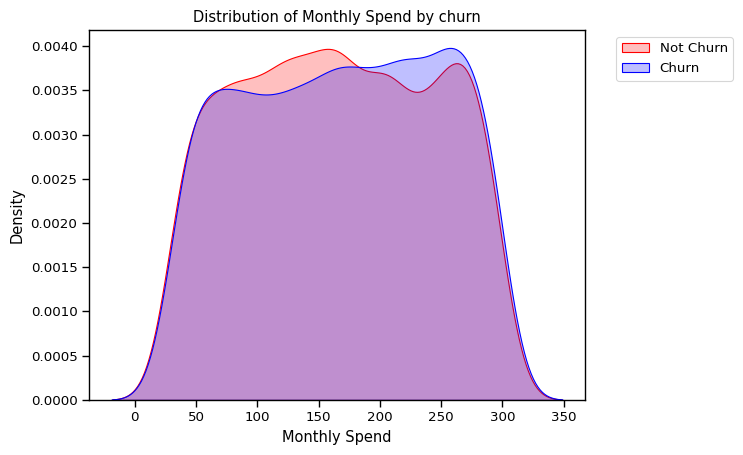

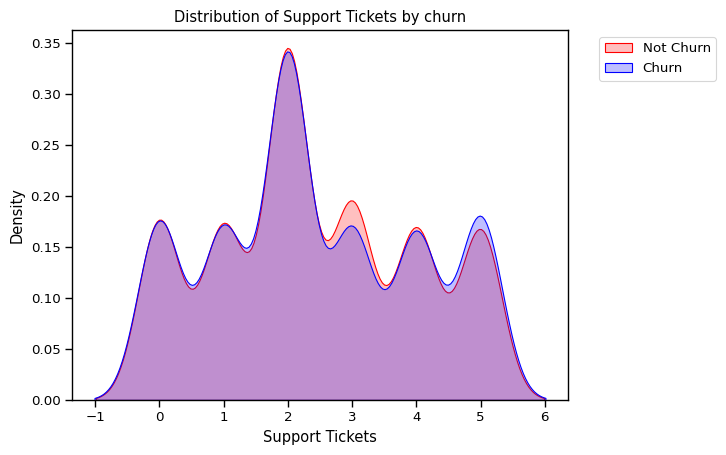

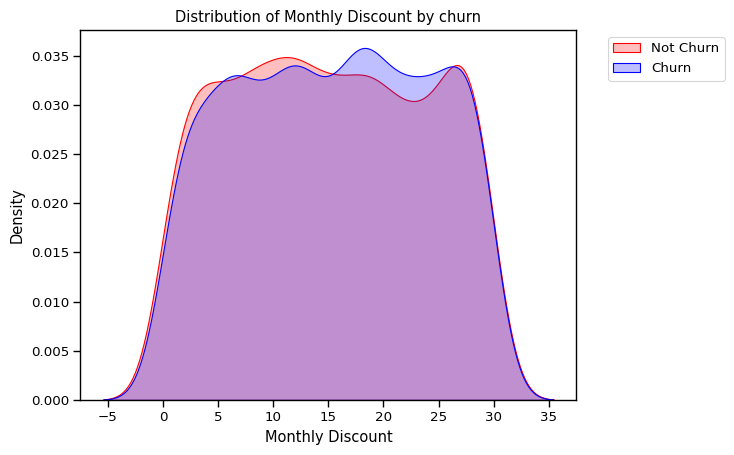

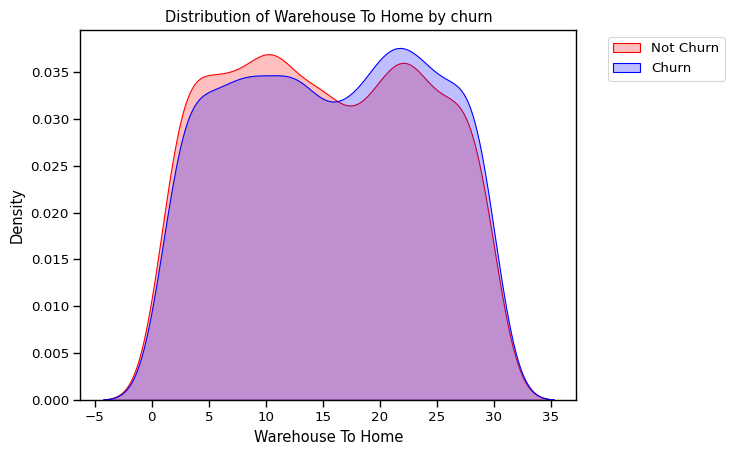

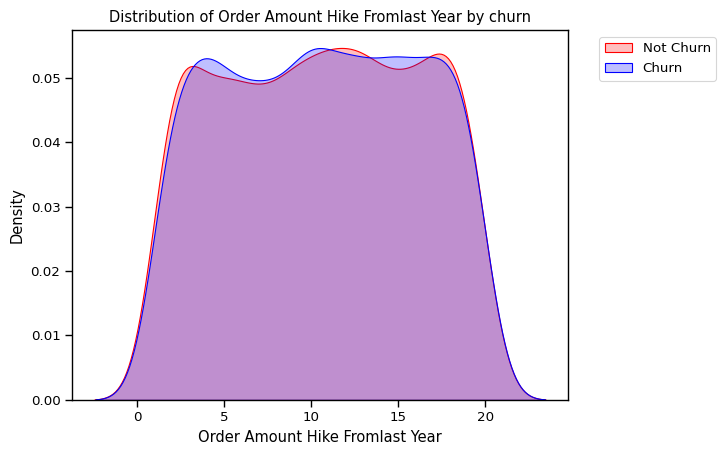

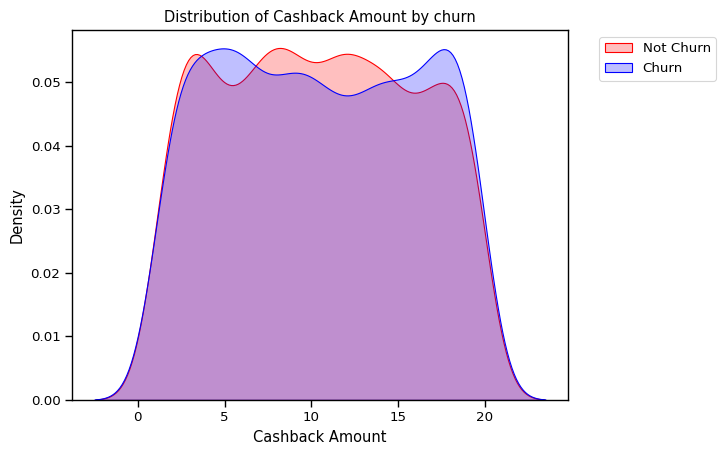

In [27]:
for item in df.drop('Address', axis=1).select_dtypes(include=['float']).columns.tolist():
    
    kde_churn_plot(df, item)

- **Motnlty Spend**: The distribution looks similar. Thus, customers who have higher montly spend having higher chance to churn
- **Support tickets**: Customers who open more support tickets are more likely to churn
- **Motnly Discount**: The distibution looks similar in the 1st iteration
- **Warehouse To Home**: Customers who's distance between thir address and home is longer are more likely to churn (need more infor on the feature)
- **Order Amount Hike From Last Year**: Distibution looks similar
- **Cashback Amount**: Customers who have lower cashback amount and maximum cachback amount are more likely to churn

In [28]:
def bar_churn_plot(df: pd.DataFrame, column: str):
    
    formatted_column = ' '.join(re.findall('[A-Z][^A-Z]*', column))
    
    sns.set_context("paper", font_scale=1.1)
    
    plt.figure(figsize=(12, 6))
    ax = sns.countplot(x=column, hue="Churn", data=df, palette='husl')
    
    ax.set_ylabel('Count')
    ax.set_xlabel(f'{formatted_column}')
    ax.set_title(f'Distribution of {formatted_column} by churn')
    ax.legend(title='Churn', labels=['Not Churn', 'Churn'], bbox_to_anchor=(1.05, 1), loc='upper left')
    
    plt.show()

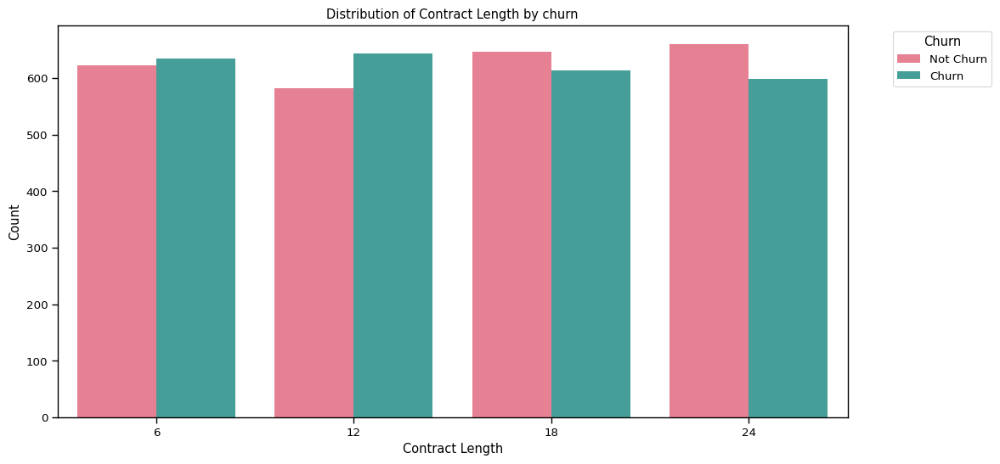

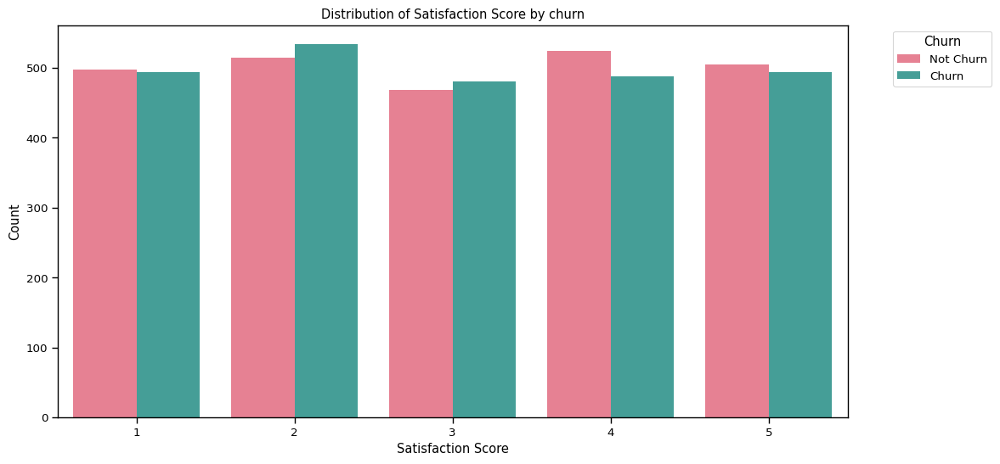

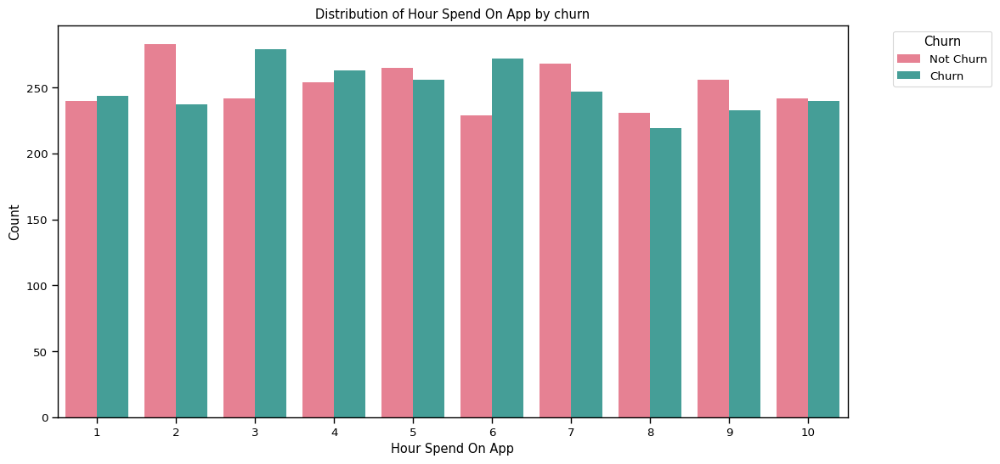

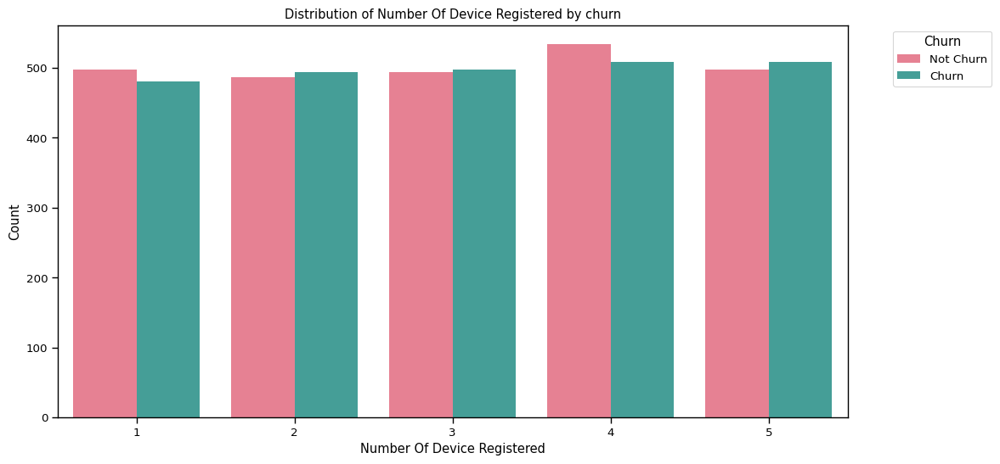

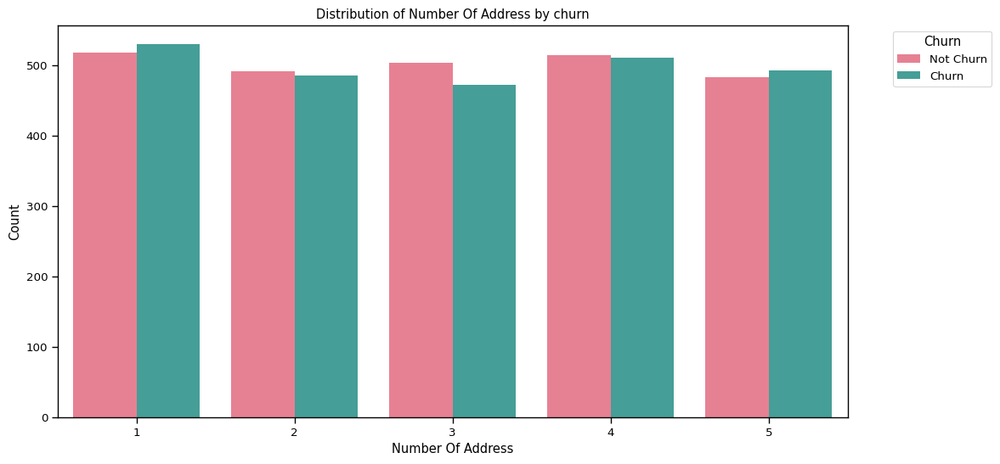

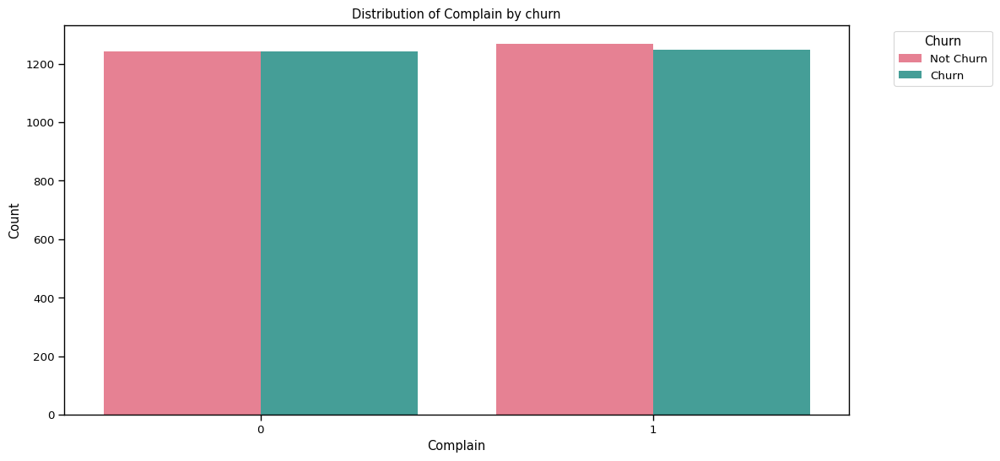

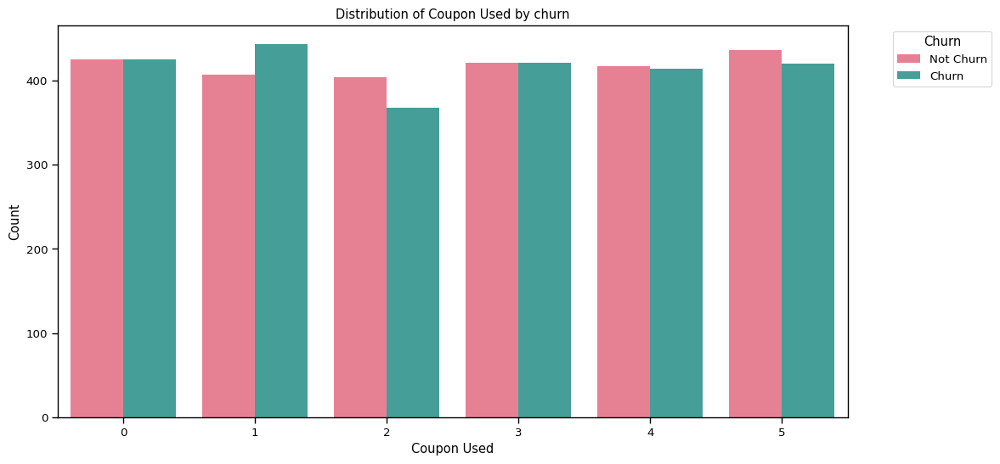

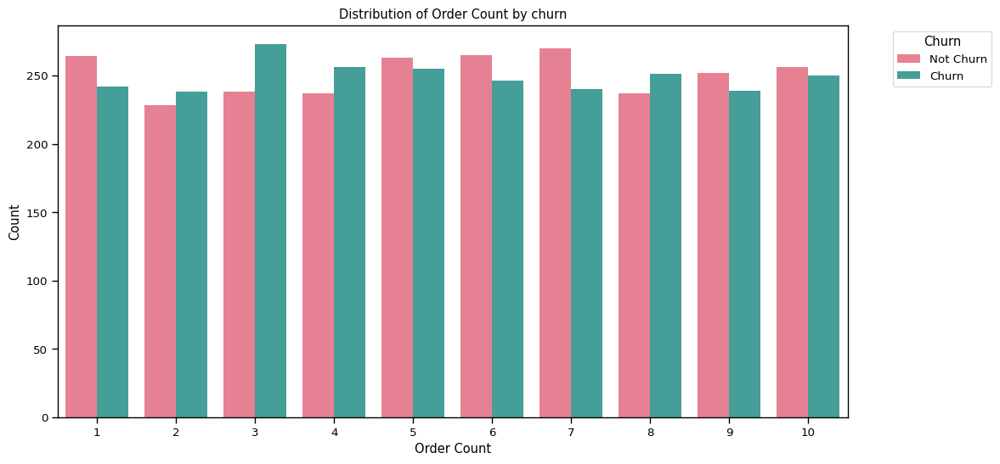

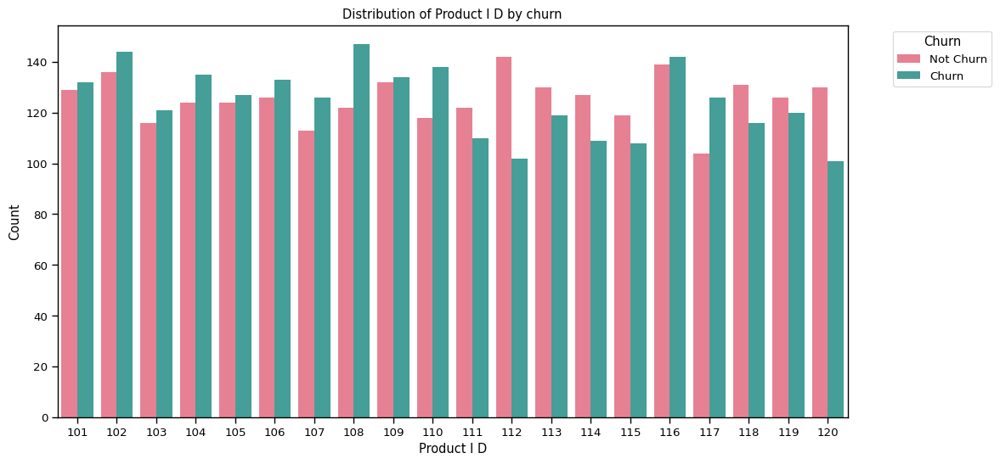

In [29]:
for item in df.drop(['Address', 'CustomerID', 'Age', 'Tenure', 'Churn', 'ProductUsage', 'DaySinceLastOrder'],
                    axis=1).select_dtypes(include=['int']).columns.tolist():
    
    bar_churn_plot(df, item)

- **Contract Length**: Users with longer contract length such as 18 and 24 month have less chance to churn.
- **Satisfaction Score**: Users with higher satisfaction score are less likely to churn.
- **Hour Spend on App**: There are 2 thresholds 3 and 6 hours. After 3 to 6 there are less users that churn. If user spend more than 6 hours on app he or she is less likely to churn.
- **Number of Device**: The balance between churn and not looks in most cases similar. Thus, there's one case that stands out, when there are 4 devices registered user is less likely to churn.
- **Number of Address**: Both classes seems to be balanced. Thus, users who have 3 adresses registered are more likely to churn. This hypothesis needs additional confirmation and might be related to the sample that have been taken.
- **Number of complain**: Users who have a complain are more likely to chur. Thus, the difference is not that hughe (needs additional confirmation).
- **Coupon Used**: In case of 0, 3 or 4 coupons used by user the number of churn and users who stayed with the company is the same. In case of 1 coupon there's a higher chance of churn. In case of 5 coupons the chance of churn is smaller.
- **Order Count**: The more order is made by user the less chance of churn is. Thus, there's one case that stands out is 8 items, this can be related to the sampling that was made and needs further investigation.
- **Product ID**: There are several products which seems not satisfy customers and causing churn. Such product IDs as <span style='color: red;'> 102, 104, 106, 107, 108, 110, 117</span>. Quality of these products should be investigated by the platform owners.

In [12]:
def boxplot_col_churn(df: pd.DataFrame, col: str):
    
    formatted_column = ' '.join(re.findall('[A-Z][^A-Z]*', column))

    fig = px.box(df, x='Churn', y=col, points="all")

    # Update yaxis properties
    fig.update_yaxes(title_text=col, row=1, col=1)
    # Update xaxis properties
    fig.update_xaxes(title_text='Churn', row=1, col=1)

    # Update size and title
    fig.update_layout(autosize=True, width=750, height=600,
                      title_font=dict(size=25, family='Courier'),
                      title=f'<b>{formatted_column} vs Churn</b>',
                      )

    fig.show()

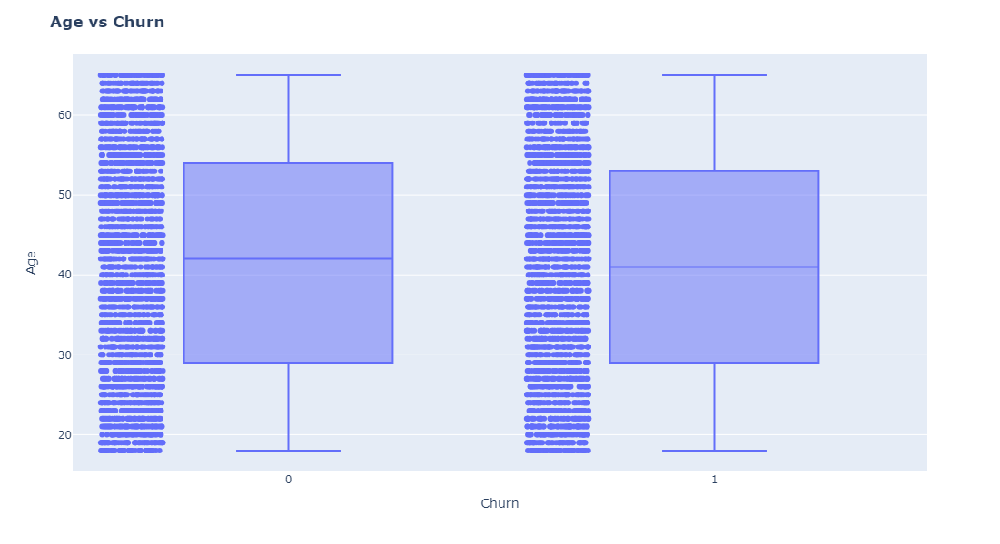

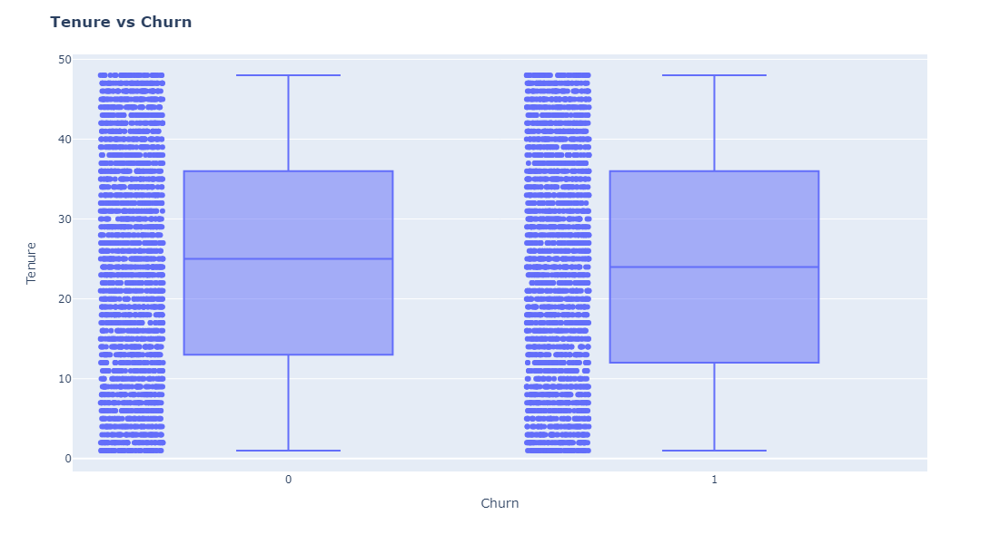

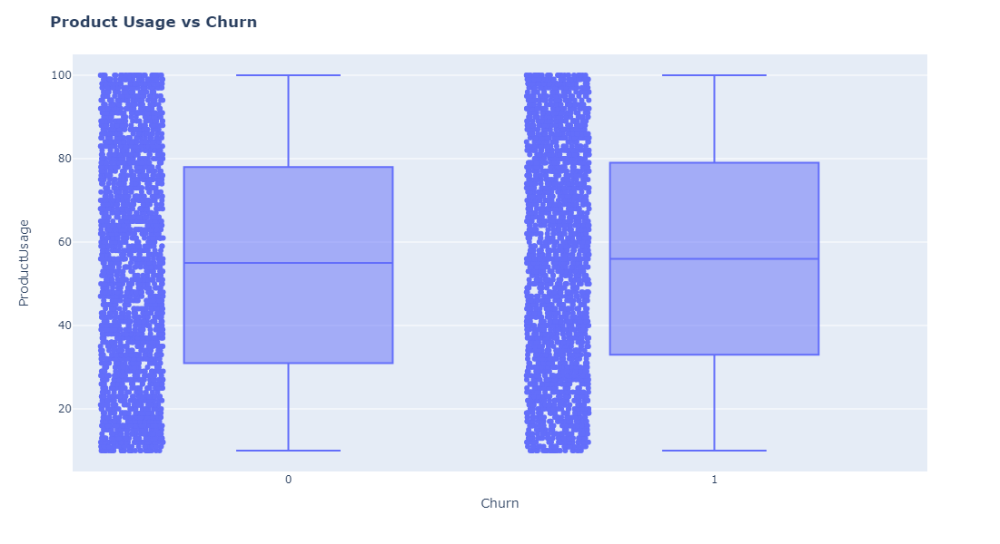

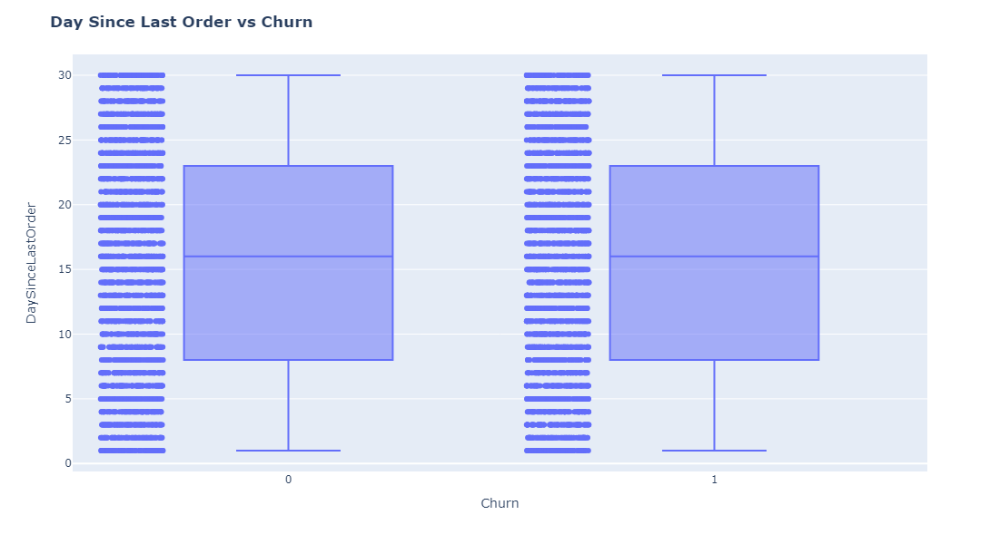

In [13]:
cols_to_investigate = ['Age', 'Tenure', 'ProductUsage', 'DaySinceLastOrder']

for column in cols_to_investigate:
    
    boxplot_col_churn(df, column)

Among columns 'Age', 'Tenure', 'ProductUsage' and 'DaySinceLastOrder' there are no visible traces of the exact reason to churn since medians above for both churned and customers who decided to stay are on the same level.

# Feature Engineering

In this sections I will create features which help us better understand customers.

- `TotalCategoriesOrdered`: This feature calculates the total number of unique categories ordered by each customer.
- `CouponUsedToOrderCountRatio`: This feature calculates the ratio of the number of coupons used to the total order count for each customer, adding a small epsilon to avoid division by zero.

In [119]:
df['TotalCategoriesOrdered'] = df.groupby('CustomerID')['PreferedOrderCat'].transform('nunique')

# Avoid division by zero by adding a small epsilon
epsilon = 1e-8

df['CouponUsedToOrderCountRatio'] = df['CouponUsed'] / (df['OrderCount'] + epsilon)

Since we have know `MontlySpend` and we know categories. We can create user monthly spend per category.

In [120]:
category_column_mapping = {
    'Books': 'MonthlySpend_Books',
    'Clothing': 'MonthlySpend_Clothing',
    'Toys': 'MonthlySpend_Toys',
    'Electronics': 'MonthlySpend_Electronics'
}

for category, column_name in category_column_mapping.items():
    # Create a new column for each category and set the initial value to 0
    df[column_name] = 0
    
    # Use groupby to sum the monthly spend for each customer and category
    category_total_spend = df[df['PreferedOrderCat'] == category].groupby('CustomerID')['MonthlySpend'].sum()
    
    # Update the corresponding rows in the new column
    df.loc[df['PreferedOrderCat'] == category, column_name] = df.loc[df['PreferedOrderCat'] == category, 'CustomerID'].map(category_total_spend)

In [121]:
df.drop('PreferedOrderCat', axis=1, inplace=True)

Average cashback amount per order can be helpful in the analysis.

In [122]:
df['AverageCashback'] = df.groupby('CustomerID')['CashbackAmount'].transform('mean')

Shopping frequencty can also help us identify customers which are more likely to churn.

In [123]:
df['BuyingFrequency'] = 1 / df.groupby('CustomerID')['DaySinceLastOrder'].transform('mean')

Extracting `State` from the `Address` might be useful since if company have competitors within the state they may cause them to churn.

In [124]:
df['State'] = df['Address'].str.extract(r',\s*([A-Za-z]+)\s*\d*')

df['State'].fillna('NA', inplace=True)

df['City'] = df['Address'].apply(lambda x: x.split('\n')[-1].rsplit(', ', 1)[0])

In [125]:
df['SupportTicketRatio'] = df['SupportTickets'] / df['Tenure']
df['SupportTicketRatio'] = df['SupportTicketRatio'].fillna(0)

In [126]:
df['LoyaltyIndicator'] = df['Tenure'] >= df['ContractLength']

In [127]:
df['DiscountUtilizationRate'] = df['MonthlyDiscount'] / df['MonthlySpend']
df['DiscountUtilizationRate'] = df['DiscountUtilizationRate'].fillna(0)

In [128]:
plt.figure(figsize=(14,7))
df.select_dtypes(include=['int', 'float']).corr()['Churn'].sort_values(ascending = False)

Churn                          1.000000
WarehouseToHome                0.029240
MonthlySpend_Books             0.026056
MonthlySpend_Toys              0.025361
MonthlySpend                   0.021933
ProductUsage                   0.016682
MonthlyDiscount                0.015980
BuyingFrequency                0.011431
CashbackAmount                 0.010712
TotalCategoriesOrdered         0.009338
SupportTicketRatio             0.009245
AverageCashback                0.008849
SupportTickets                 0.005206
OrderAmountHikeFromlastYear    0.003467
NumberOfDeviceRegistered       0.003466
DiscountUtilizationRate        0.000331
NumberOfAddress               -0.000477
Age                           -0.002557
Complain                      -0.004376
DaySinceLastOrder             -0.004678
HourSpendOnApp                -0.006267
CouponUsed                    -0.009275
MonthlySpend_Clothing         -0.009345
SatisfactionScore             -0.009759
OrderCount                    -0.009767


<Figure size 1400x700 with 0 Axes>

In [129]:
df.drop(['NumberOfDeviceRegistered', 'NumberOfAddress', 'OrderAmountHikeFromlastYear', 
         'ProductID', 'Complain', 'DaySinceLastOrder'], axis=1, inplace=True)

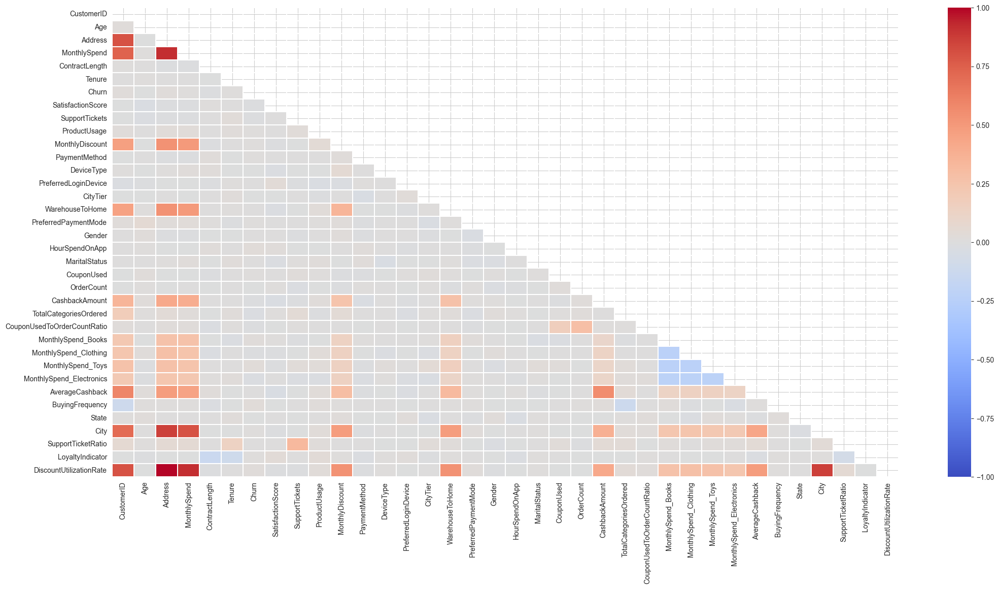

In [131]:
plt.figure(figsize=(25, 12))

corr = df.apply(lambda x: pd.factorize(x)[0]).corr()

mask = np.triu(np.ones_like(corr, dtype=bool))

ax = sns.heatmap(corr, mask=mask, 
                 xticklabels=corr.columns, 
                 yticklabels=corr.columns, 
                 annot=True, 
                 linewidths=.2, 
                 cmap='coolwarm', 
                 vmin=-1, 
                 vmax=1
                )

___
# Outliers

Let's test our data for outliers. Outliers can potentially introduce bias to our Machine Learning model.

In [128]:
def traditional_outlier(df, col):
    
    df_test = df.copy(deep=True)
    
    # Calculate the first quartile (Q1) and third quartile (Q3)
    q1 = df[col].quantile(.25)
    q3 = df[col].quantile(.75)
    
    # Calculate the interquartile range (IQR)
    iqr = q3 - q1
    
     # Assign outlier values using the traditional method
    df_test['Traditional'] = np.where(df[[col]] < (q1 - 1.5 * iqr), -1,
                                     np.where(df[[col]] > (q3 + 1.5 * iqr), -1, 1))
    
    # Return a DataFrame containing rows with traditional outliers
    return df_test[df_test.Traditional == -1]    

In [129]:
traditional_outlier(df, 'DaySinceLastOrder')

,CustomerID,Age,Address,MonthlySpend,ContractLength,Tenure,Churn,SatisfactionScore,SupportTickets,ProductUsage,...,OrderCount,DaySinceLastOrder,CashbackAmount,ProductID,MonthlySpend_Books,MonthlySpend_Clothing,MonthlySpend_Toys,MonthlySpend_Electronics,AverageCashback,Traditional


In [130]:
traditional_outlier(df, 'HourSpendOnApp')

,CustomerID,Age,Address,MonthlySpend,ContractLength,Tenure,Churn,SatisfactionScore,SupportTickets,ProductUsage,...,OrderCount,DaySinceLastOrder,CashbackAmount,ProductID,MonthlySpend_Books,MonthlySpend_Clothing,MonthlySpend_Toys,MonthlySpend_Electronics,AverageCashback,Traditional


In [100]:
traditional_outlier(df, 'OrderCount')

,CustomerID,Age,Address,MonthlySpend,ContractLength,Tenure,Churn,SatisfactionScore,SupportTickets,ProductUsage,...,CouponUsed,OrderCount,DaySinceLastOrder,CashbackAmount,ProductID,MonthlySpend_Books,MonthlySpend_Clothing,MonthlySpend_Toys,MonthlySpend_Electronics,Traditional


In [131]:
traditional_outlier(df, 'AverageCashback')

,CustomerID,Age,Address,MonthlySpend,ContractLength,Tenure,Churn,SatisfactionScore,SupportTickets,ProductUsage,...,OrderCount,DaySinceLastOrder,CashbackAmount,ProductID,MonthlySpend_Books,MonthlySpend_Clothing,MonthlySpend_Toys,MonthlySpend_Electronics,AverageCashback,Traditional


It seems like there are no traditional outliers in the `DataFrame`.

___
# Data Preprocessing

In order keep variables in the same dimention we need to prepocess them. For the `object` types we can use `LabelEncoder` or `TargetEncoder`. For columns of the dtype `float` we can use scalers such as `StandardScaler`.

**Note**: Thus, `LabelEncoder` documentation is said that it can be used only to modify `y` and not `X` value, kaggle experts provide solutions with such encoding which give high quality of prediction.

**Note**: In order for the model to be used for the new data it is better to write custom scaler. For instance, if we use `MinMaxScaler` the max and min values can be different in the new dataset. As the result we will get prediction which will be invalid. But for seak of simplicity we can stay with ready to use solutions.

In [132]:
# Dropping not useful columns

df.drop(['CustomerID', 'Address'], axis=1, inplace=True)

In [133]:
def multiple_dummies(df: pd.DataFrame, col_list: list, prefixes: list, drop_first=True) -> pd.DataFrame:
    
    for col, prefix in zip(col_list, prefixes):
        
        df = pd.get_dummies(df, columns=[col], prefix=[prefix], drop_first=drop_first)
        
    return df

In [134]:
df.select_dtypes(include=['object']).columns.tolist()

['PaymentMethod',
 'DeviceType',
 'PreferredLoginDevice',
 'CityTier',
 'PreferredPaymentMode',
 'Gender',
 'MaritalStatus',
 'State',
 'City']

In [135]:
df_cat = multiple_dummies(df, col_list = ['PaymentMethod', 'DeviceType', 'PreferredLoginDevice', 
                                     'CityTier', 'PreferredPaymentMode',
                                     'Gender', 'MaritalStatus', 'State', 'City'], 
                     prefixes=['pay_method', 'dev_type', 'log_dev', 'city', 
                               'payment_method', 'gender', 'mar_stat', 'state', 'city']
                     )

In [136]:
df_cat.columns

Index(['Age', 'MonthlySpend', 'ContractLength', 'Tenure', 'Churn',
       'SatisfactionScore', 'SupportTickets', 'ProductUsage',
       'MonthlyDiscount', 'WarehouseToHome',
       ...
       'city_Yvetteburgh', 'city_Yvonnemouth', 'city_Zacharymouth',
       'city_Zacharystad', 'city_Zacharyton', 'city_Zamoraton',
       'city_Zhanghaven', 'city_Zhangshire', 'city_Zoeberg', 'city_Zoeton'],
      dtype='object', length=4502)

Standardizing numerical values.

In [137]:
num_col = df_cat.drop('Churn', axis=1).select_dtypes(include=['int', 'float']).columns.tolist()

In [138]:
def distplot(feature, frame, color='r'):
    
    plt.figure(figsize=(8,3))
    
    plt.title("Distribution for {}".format(feature))
    
    ax = sns.distplot(frame[feature], color= color)

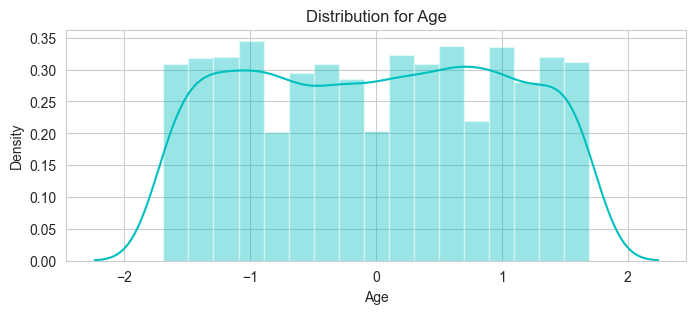

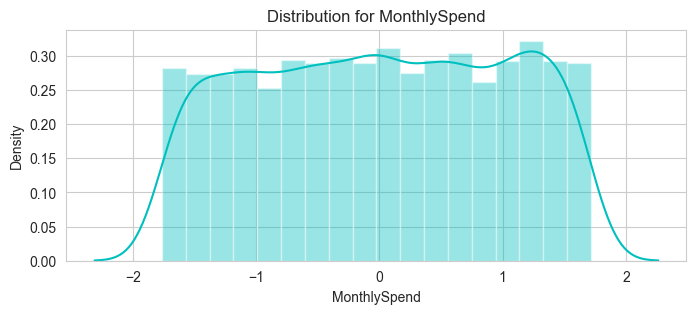

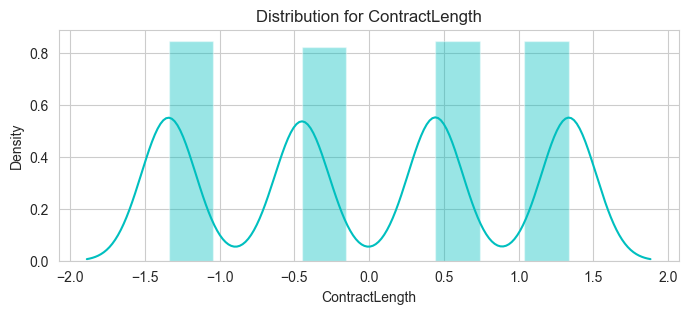

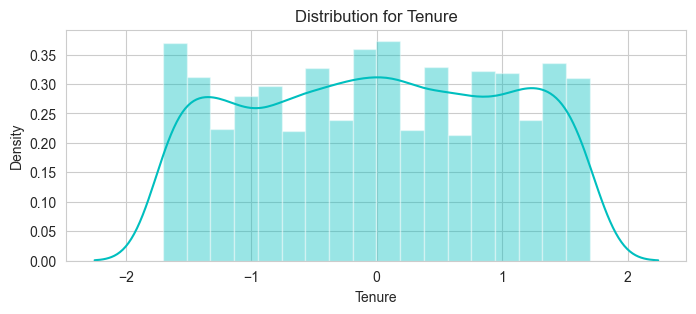

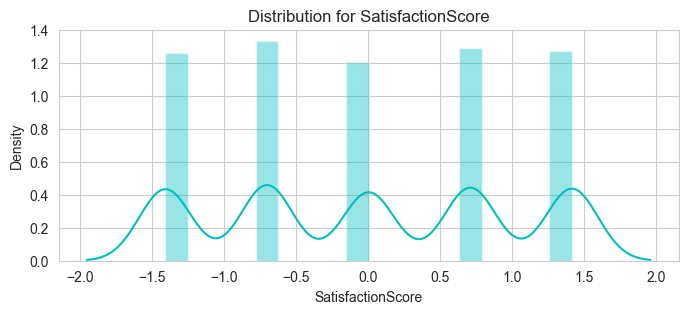

...

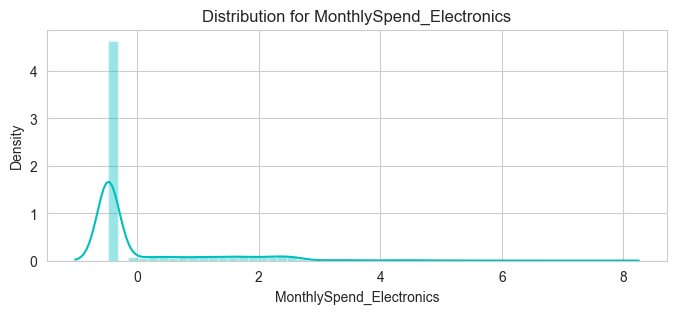

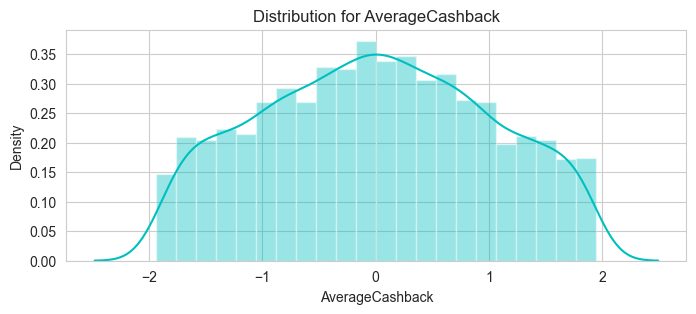

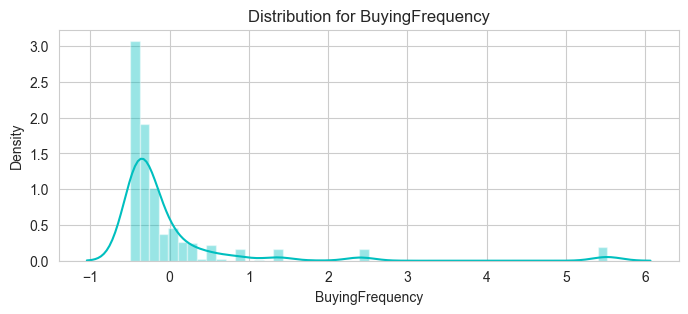

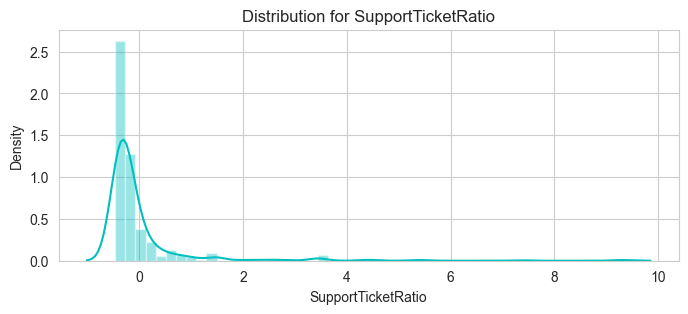

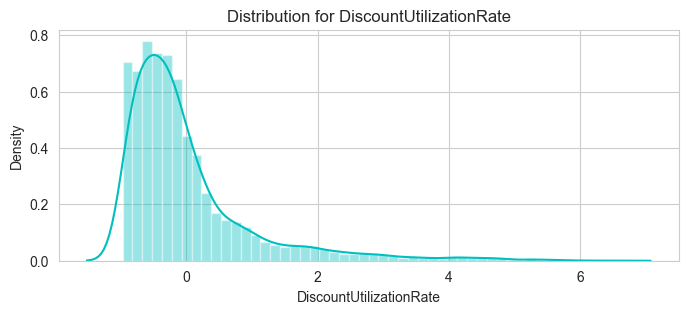

In [139]:
df_cat[num_col] = pd.DataFrame(StandardScaler().fit_transform(df_cat[num_col].astype('float64')),
                       columns=num_col)
for feat in num_col: distplot(feat, df_cat, color='c')

In [140]:
df_cat['Churn'] = df_cat['Churn'].astype('bool')

___
# PCA Analysis

To better understand underlying structure of the data Principal Component Analysis should be carried out. As the result of the analysis, having our features scaled we can see the shape of the data in regards to churn.

In [141]:
from sklearn.decomposition import PCA

In [142]:
df_cat.select_dtypes(include=['int', 'float']).columns

Index(['Age', 'MonthlySpend', 'ContractLength', 'Tenure', 'SatisfactionScore',
       'SupportTickets', 'ProductUsage', 'MonthlyDiscount', 'WarehouseToHome',
       'HourSpendOnApp', 'CouponUsed', 'OrderCount', 'CashbackAmount',
       'TotalCategoriesOrdered', 'CouponUsedToOrderCountRatio',
       'MonthlySpend_Books', 'MonthlySpend_Clothing', 'MonthlySpend_Toys',
       'MonthlySpend_Electronics', 'AverageCashback', 'BuyingFrequency',
       'SupportTicketRatio', 'DiscountUtilizationRate'],
      dtype='object')

In [145]:
features = ['Age', 'MonthlySpend', 'ContractLength', 'Tenure', 'SatisfactionScore',
            'SupportTickets', 'ProductUsage', 'MonthlyDiscount', 'WarehouseToHome',
            'HourSpendOnApp', 'CouponUsed', 'OrderCount',
            'CashbackAmount', 'TotalCategoriesOrdered', 'CouponUsedToOrderCountRatio', 'MonthlySpend_Books',
            'MonthlySpend_Clothing', 'MonthlySpend_Toys',
            'MonthlySpend_Electronics', 'AverageCashback', 'BuyingFrequency', 'SupportTicketRatio', 'DiscountUtilizationRate']

In [146]:
df_to_analysis = df_cat[features]

In [147]:
def pca_analysis(df, n_components):
    
    pca = PCA(n_components=n_components)
    
    pca.fit(df)
    
    pca_samples = pca.transform(df)
    
    return pca_samples

In [148]:
pca_samples = pca_analysis(df_to_analysis, 2)

In [149]:
def pca_plot(df, col, pca_samples):
    
    color_map = {False: 'blue', True: 'orange'}
    colors = df[col].map(color_map)

    sns.set_style('whitegrid')

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(pca_samples[:, 0], pca_samples[:, 1], c=colors)
    plt.xlabel('First principal component')
    plt.ylabel('Second principal component')
    legend_labels = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=str(label)) for label, color in color_map.items()]
    plt.legend(handles=legend_labels, title='Churn')

    plt.show()

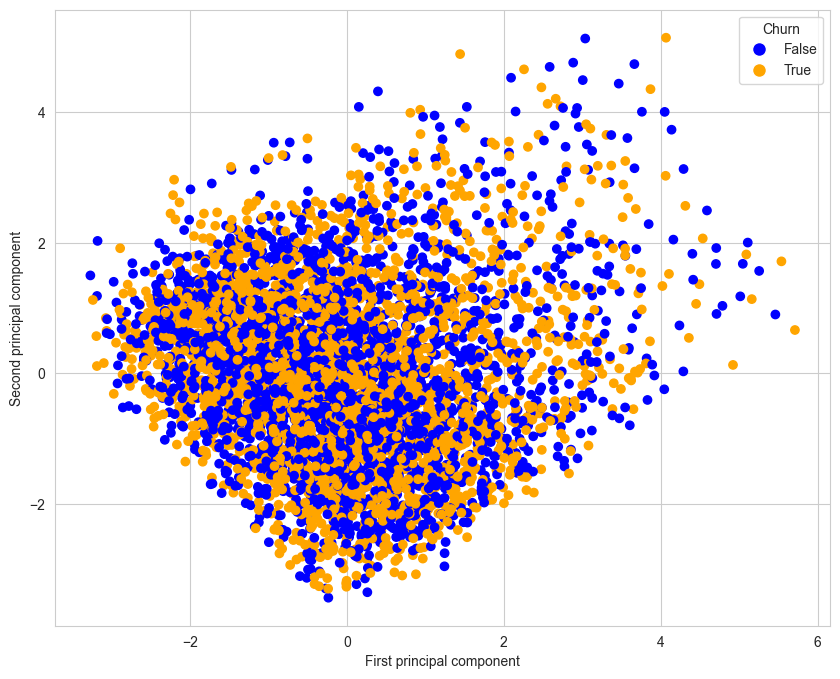

In [150]:
pca_plot(df_cat, 'Churn', pca_samples)

From the PCA it seems like the data is very much mixed and there is no clustering or trend withing the data. One way to address that and prove or disprove this statement is to plot PCA analysis for 3 components.

In [151]:
pca_samples_3d = pca_analysis(df_to_analysis, 3)

In [152]:
def pca_plot_3d(df, col, pca_samples):
    
    z = pca_samples[:, 2]
    x = pca_samples[:, 0]
    y = pca_samples[:, 1]
    
    
    color_map = {False: 'blue', True: 'orange'}
    colors = df[col].map(color_map)

    sns.set_style('whitegrid')

    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))

    # Plot x and y
    scatter1 = axes[0].scatter(x, y, c=colors)
    axes[0].set_xlabel('First principal component')
    axes[0].set_ylabel('Second principal component')
    axes[0].set_title('X and Y')

    # Plot z and y
    scatter2 = axes[1].scatter(z, y, c=colors)
    axes[1].set_xlabel('Third principal component')
    axes[1].set_ylabel('Second principal component')
    axes[1].set_title('Z and Y')

    # Plot x and z
    scatter3 = axes[2].scatter(x, z, c=colors)
    axes[2].set_xlabel('First principal component')
    axes[2].set_ylabel('Third principal component')
    axes[2].set_title('X and Z')

    # Add legend to the first plot
    legend_labels = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=str(label)) for label, color in color_map.items()]
    axes[0].legend(handles=legend_labels, title='Churn')

    plt.tight_layout()
    plt.show()

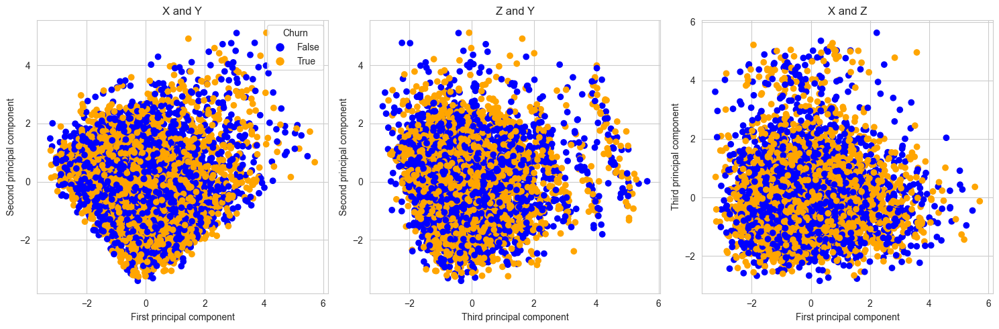

In [153]:
pca_plot_3d(df_cat, 'Churn', pca_samples_3d)

From the 3D view it looks like there's not visible clusters.

___
# Model Training and eveluation

I will train several models on the dataset. The best model will be explained via the `shap` XAi.

In [154]:
import optuna
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score,  precision_recall_curve, average_precision_score, roc_curve, auc

In [155]:
X = df_cat.drop(columns = ['Churn'])
y = df_cat['Churn']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 42)

As the metric  `precision_score` is chosen since for the business it is valuable to change treatment for the customers who have high chance to churn.

## Random Forest Classifier

In [156]:
def objective(trial):

    n_estimators = trial.suggest_int('n_estimators', 50, 400)
    max_depth = trial.suggest_int('max_depth', 3, 25)
    min_samples_split = trial.suggest_float('min_samples_split', 0.1, 1.0)
    min_samples_leaf = trial.suggest_float('min_samples_leaf', 0.1, 0.5)
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None])

    # Create and train the Random Forest model
    model = RandomForestClassifier(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_features=max_features,
        random_state=42
    )
    
    model.fit(X_train, y_train)

    # Get predicted probabilities for the validation set
    y_pred = model.predict(X_test)
    

    # Calculate AUC-ROC
    auc_roc = accuracy_score(y_test, y_pred)

    return auc_roc

In [157]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=600, n_jobs=6)

[I 2024-01-25 17:35:27,838] A new study created in memory with name: no-name-38894d65-b405-496c-a199-3654cd383a1d
[I 2024-01-25 17:35:28,775] Trial 1 finished with value: 0.4886666666666667 and parameters: {'n_estimators': 82, 'max_depth': 19, 'min_samples_split': 0.9996351896226705, 'min_samples_leaf': 0.1377400725039576, 'max_features': 'sqrt'}. Best is trial 1 with value: 0.4886666666666667.
[I 2024-01-25 17:35:29,148] Trial 0 finished with value: 0.4886666666666667 and parameters: {'n_estimators': 92, 'max_depth': 21, 'min_samples_split': 0.10707815086440298, 'min_samples_leaf': 0.10932903055895134, 'max_features': 'log2'}. Best is trial 1 with value: 0.4886666666666667.
[I 2024-01-25 17:35:29,768] Trial 2 finished with value: 0.4886666666666667 and parameters: {'n_estimators': 90, 'max_depth': 17, 'min_samples_split': 0.8959625759367629, 'min_samples_leaf': 0.49287793166204286, 'max_features': 'sqrt'}. Best is trial 1 with value: 0.4886666666666667.
[I 2024-01-25 17:35:31,149] Tri

In [158]:
best_params = study.best_params

print('The best parameters are: ', best_params)

The best parameters are:  {'n_estimators': 374, 'max_depth': 13, 'min_samples_split': 0.4777161616765025, 'min_samples_leaf': 0.30696628195936215, 'max_features': None}


In [159]:
model = RandomForestClassifier(**best_params, random_state=42)
model.fit(X_train, y_train)

RandomForestClassifier(max_depth=13, max_features=None,
                       min_samples_leaf=0.30696628195936215,
                       min_samples_split=0.4777161616765025, n_estimators=374,
                       random_state=42)

In [160]:
y_pred_proba_test = model.predict_proba(X_test)[:, 1]
y_pred = model.predict(X_test)

In [161]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

       False       0.50      0.75      0.60       733
        True       0.54      0.28      0.36       767

    accuracy                           0.51      1500
   macro avg       0.52      0.51      0.48      1500
weighted avg       0.52      0.51      0.48      1500



In [162]:
fpr, tpr, _ = roc_curve(y_test, y_pred_proba_test)
roc_auc = auc(fpr, tpr)

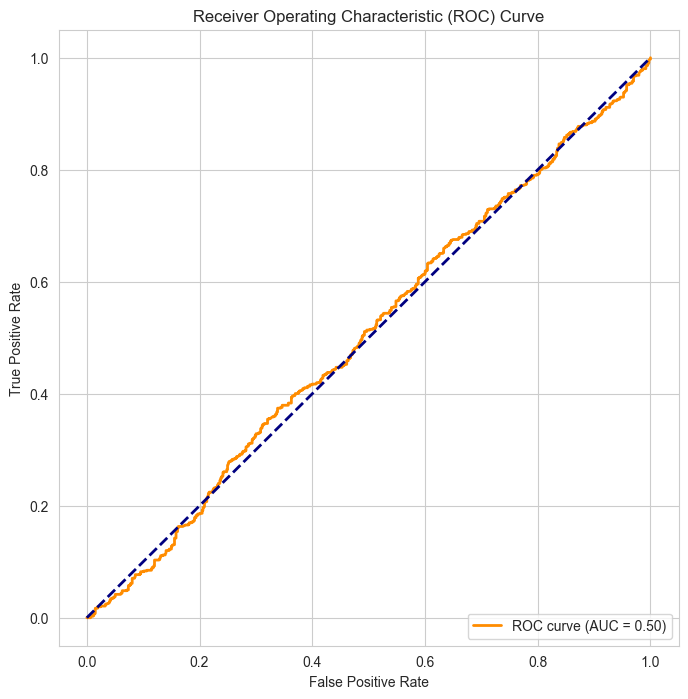

In [163]:
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

In [164]:
precision, recall, _ = precision_recall_curve(y_test, y_pred_proba_test)
average_precision = average_precision_score(y_test, y_pred_proba_test)

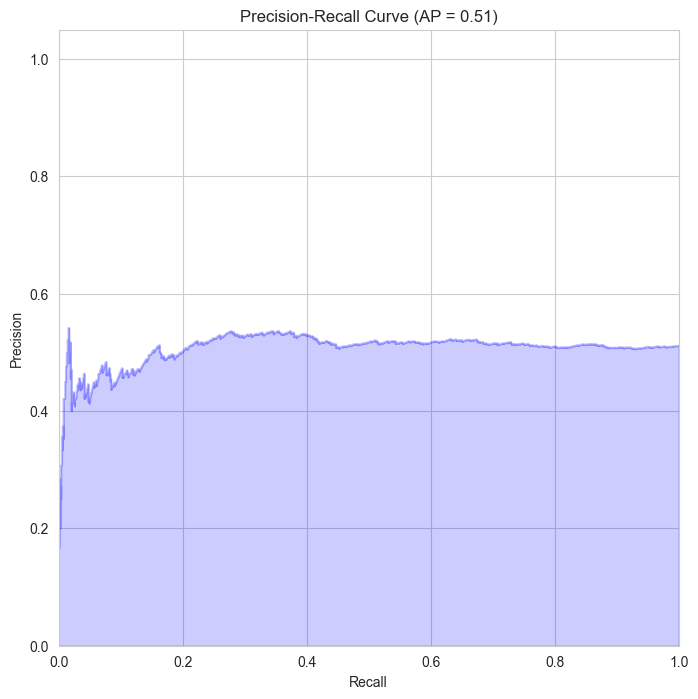

In [165]:
plt.figure(figsize=(8, 8))
plt.step(recall, precision, color='b', alpha=0.2, where='post')
plt.fill_between(recall, precision, step='post', alpha=0.2, color='b')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title('Precision-Recall Curve (AP = {:.2f})'.format(average_precision))
plt.show()

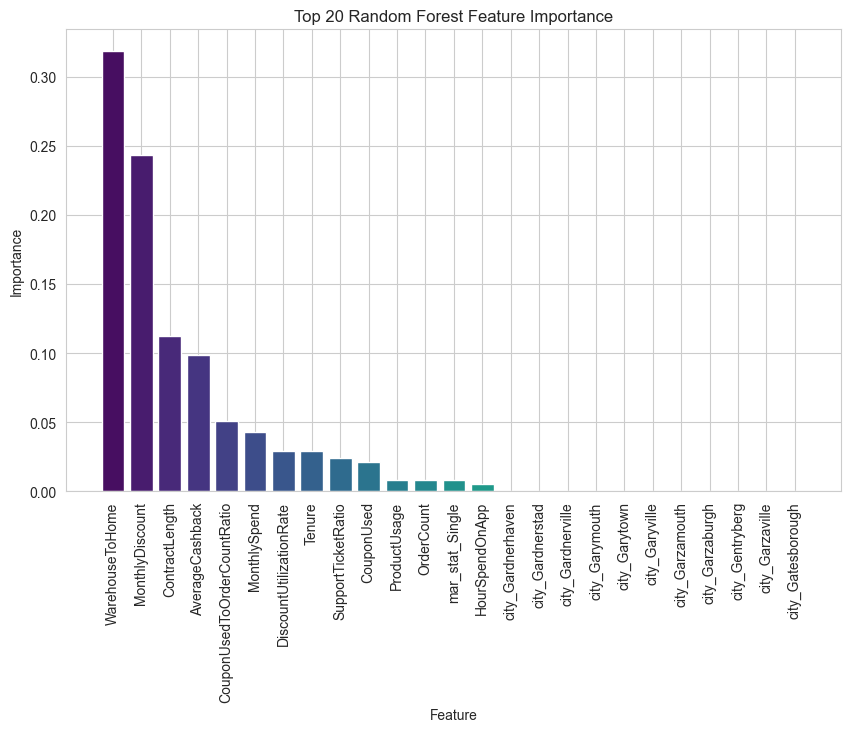

In [166]:

feature_importance = model.feature_importances_

feature_names = X.columns

top20_idx = feature_importance.argsort()[-25:][::-1]

top20_feature_importance = feature_importance[top20_idx]
top20_feature_names = feature_names[top20_idx]

colors = sns.color_palette("viridis", len(top20_feature_importance))

plt.figure(figsize=(10, 6))
plt.bar(range(len(top20_feature_importance)), top20_feature_importance, align="center", color=colors)
plt.xticks(range(len(top20_feature_importance)), top20_feature_names, rotation='vertical')
plt.xlabel("Feature")
plt.ylabel("Importance")
plt.title("Top 20 Random Forest Feature Importance")
plt.show()

In [167]:
import shap

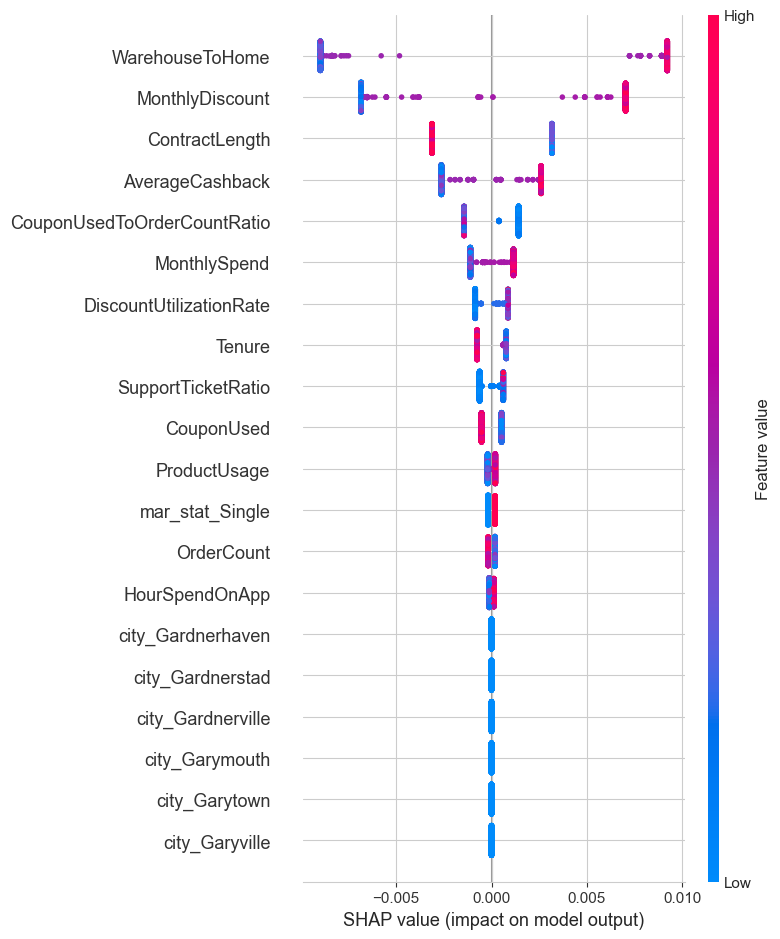

In [168]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values[1], X_test)

## XGBoost Classifier

In [85]:
def objective(trial):
    
    dtrain = xgb.DMatrix(X_train, label=y_train)
    dvalid = xgb.DMatrix(X_test, label=y_test)
    
    param = {
        "verbosity": 0,
        "objective": "binary:logistic",
        # use exact for small dataset.
        "tree_method": "exact",
        # defines booster, gblinear for linear functions.
        "booster": trial.suggest_categorical("booster", ["gbtree", "gblinear", "dart"]),
        # L2 regularization weight.
        "lambda": trial.suggest_float("lambda", 1e-8, 1.0, log=True),
        # L1 regularization weight.
        "alpha": trial.suggest_float("alpha", 1e-8, 1.0, log=True),
        # sampling ratio for training data.
        "subsample": trial.suggest_float("subsample", 0.2, 1.0),
        # sampling according to each tree.
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.2, 1.0),
    }

    if param["booster"] in ["gbtree", "dart"]:
        # maximum depth of the tree, signifies complexity of the tree.
        param["max_depth"] = trial.suggest_int("max_depth", 3, 9, step=2)
        # minimum child weight, larger the term more conservative the tree.
        param["min_child_weight"] = trial.suggest_int("min_child_weight", 2, 10)
        param["eta"] = trial.suggest_float("eta", 1e-8, 1.0, log=True)
        # defines how selective algorithm is.
        param["gamma"] = trial.suggest_float("gamma", 1e-8, 1.0, log=True)
        param["grow_policy"] = trial.suggest_categorical("grow_policy", ["depthwise", "lossguide"])

    if param["booster"] == "dart":
        param["sample_type"] = trial.suggest_categorical("sample_type", ["uniform", "weighted"])
        param["normalize_type"] = trial.suggest_categorical("normalize_type", ["tree", "forest"])
        param["rate_drop"] = trial.suggest_float("rate_drop", 1e-8, 1.0, log=True)
        param["skip_drop"] = trial.suggest_float("skip_drop", 1e-8, 1.0, log=True)
        
    bst = xgb.train(param, dtrain)
    
    preds = bst.predict(dvalid)
    y_pred = np.rint(preds)
    
    precision = precision_score(y_test, y_pred)
    
    return precision

In [86]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=140)

[I 2024-01-25 11:34:09,842] A new study created in memory with name: no-name-2220055d-e8f9-4fef-a342-681ae55cf9ce
[I 2024-01-25 11:34:12,653] Trial 0 finished with value: 0.5230769230769231 and parameters: {'booster': 'gbtree', 'lambda': 0.21262498514015812, 'alpha': 2.373711535689012e-05, 'subsample': 0.24816561902109913, 'colsample_bytree': 0.7245126637335402, 'max_depth': 9, 'min_child_weight': 2, 'eta': 3.830239211079085e-07, 'gamma': 0.12043716277707676, 'grow_policy': 'depthwise'}. Best is trial 0 with value: 0.5230769230769231.
[I 2024-01-25 11:34:15,589] Trial 1 finished with value: 0.5225988700564972 and parameters: {'booster': 'gbtree', 'lambda': 1.0522559596772397e-08, 'alpha': 0.26605505073765673, 'subsample': 0.8167464387988015, 'colsample_bytree': 0.7659466409669979, 'max_depth': 7, 'min_child_weight': 8, 'eta': 5.927783921274539e-05, 'gamma': 1.2009114814834257e-08, 'grow_policy': 'depthwise'}. Best is trial 0 with value: 0.5230769230769231.
[I 2024-01-25 11:34:18,862] T

[I 2024-01-24 21:17:03,749] Trial 44 finished with value: 0.0 and parameters: {'booster': 'dart', 'lambda': 0.001961626679856723, 'alpha': 0.005158513710097886, 'subsample': 0.6578207027114397, 'colsample_bytree': 0.9255558170912999, 'max_depth': 7, 'min_child_weight': 8, 'eta': 0.002784962596117678, 'gamma': 0.7770969500420242, 'grow_policy': 'lossguide', 'sample_type': 'uniform', 'normalize_type': 'forest', 'rate_drop': 0.00816374353369958, 'skip_drop': 2.1823234230408135e-07}. Best is trial 41 with value: 1.0.
[I 2024-01-24 21:17:03,904] Trial 45 finished with value: 0.5862068965517241 and parameters: {'booster': 'dart', 'lambda': 0.0001262311524243105, 'alpha': 0.0016793584876312463, 'subsample': 0.7634371448865036, 'colsample_bytree': 0.8125312903049374, 'max_depth': 7, 'min_child_weight': 7, 'eta': 0.0063733671453274545, 'gamma': 0.017675095414730918, 'grow_policy': 'lossguide', 'sample_type': 'uniform', 'normalize_type': 'forest', 'rate_drop': 0.011966337188718878, 'skip_drop': 

[I 2024-01-24 21:17:06,202] Trial 60 finished with value: 0.5108695652173914 and parameters: {'booster': 'dart', 'lambda': 6.395215787855594e-08, 'alpha': 0.0002994115410021258, 'subsample': 0.8674794699998559, 'colsample_bytree': 0.8144323119883397, 'max_depth': 9, 'min_child_weight': 7, 'eta': 0.007015769319768551, 'gamma': 0.022257655215292882, 'grow_policy': 'lossguide', 'sample_type': 'uniform', 'normalize_type': 'forest', 'rate_drop': 0.0042750264935419125, 'skip_drop': 1.8772216915373513e-07}. Best is trial 41 with value: 1.0.
[I 2024-01-24 21:17:06,360] Trial 61 finished with value: 0.5155642023346303 and parameters: {'booster': 'dart', 'lambda': 0.0014356237300096485, 'alpha': 9.440542858218047e-06, 'subsample': 0.7220238600649755, 'colsample_bytree': 0.9963713285186077, 'max_depth': 7, 'min_child_weight': 8, 'eta': 0.030738943341510304, 'gamma': 0.007381357107357921, 'grow_policy': 'lossguide', 'sample_type': 'uniform', 'normalize_type': 'forest', 'rate_drop': 0.2698579672749

[I 2024-01-24 21:17:08,749] Trial 76 finished with value: 0.0 and parameters: {'booster': 'gbtree', 'lambda': 0.0005345674968020523, 'alpha': 0.000211571524557976, 'subsample': 0.6156109510776085, 'colsample_bytree': 0.9732101199313246, 'max_depth': 5, 'min_child_weight': 7, 'eta': 0.0025224899726931592, 'gamma': 0.013203303620943378, 'grow_policy': 'lossguide'}. Best is trial 41 with value: 1.0.
[I 2024-01-24 21:17:08,866] Trial 77 finished with value: 1.0 and parameters: {'booster': 'gbtree', 'lambda': 0.00314781008673511, 'alpha': 0.0030677773038659322, 'subsample': 0.8991363669706594, 'colsample_bytree': 0.7549636996014053, 'max_depth': 5, 'min_child_weight': 8, 'eta': 0.006173490017531415, 'gamma': 0.001959947070884515, 'grow_policy': 'depthwise'}. Best is trial 41 with value: 1.0.
[I 2024-01-24 21:17:08,983] Trial 78 finished with value: 0.0 and parameters: {'booster': 'gbtree', 'lambda': 0.02336703092451043, 'alpha': 0.003448612653775783, 'subsample': 0.8931257341098825, 'colsam

[I 2024-01-24 21:17:11,298] Trial 95 finished with value: 0.0 and parameters: {'booster': 'dart', 'lambda': 0.003979353681598494, 'alpha': 0.007203068337470983, 'subsample': 0.5864412671694295, 'colsample_bytree': 0.8836182360787851, 'max_depth': 5, 'min_child_weight': 6, 'eta': 0.0026531265340340145, 'gamma': 0.010055694459450011, 'grow_policy': 'lossguide', 'sample_type': 'weighted', 'normalize_type': 'tree', 'rate_drop': 0.004346176832033475, 'skip_drop': 2.1135691873900183e-08}. Best is trial 41 with value: 1.0.
[I 2024-01-24 21:17:11,456] Trial 96 finished with value: 0.5076923076923077 and parameters: {'booster': 'dart', 'lambda': 0.03511465458178353, 'alpha': 0.004365993167969371, 'subsample': 0.8981792123551348, 'colsample_bytree': 0.9221391598198139, 'max_depth': 7, 'min_child_weight': 7, 'eta': 0.009594088115295265, 'gamma': 1.9191282691405515e-07, 'grow_policy': 'lossguide', 'sample_type': 'weighted', 'normalize_type': 'tree', 'rate_drop': 2.3247030668232325e-07, 'skip_drop'

[I 2024-01-24 21:17:13,768] Trial 111 finished with value: 0.5454545454545454 and parameters: {'booster': 'dart', 'lambda': 0.0002558071674253511, 'alpha': 0.0017961713902301282, 'subsample': 0.8288768535892758, 'colsample_bytree': 0.8144466470286164, 'max_depth': 7, 'min_child_weight': 7, 'eta': 0.005968018502620896, 'gamma': 0.018316926647006748, 'grow_policy': 'lossguide', 'sample_type': 'uniform', 'normalize_type': 'forest', 'rate_drop': 0.013783701699643247, 'skip_drop': 3.610823539943277e-07}. Best is trial 41 with value: 1.0.
[I 2024-01-24 21:17:13,928] Trial 112 finished with value: 0.0 and parameters: {'booster': 'dart', 'lambda': 0.00042372685706212285, 'alpha': 0.0007801836921660342, 'subsample': 0.7717065493589953, 'colsample_bytree': 0.8303104654186606, 'max_depth': 7, 'min_child_weight': 7, 'eta': 0.003736941933114202, 'gamma': 0.008739540154941768, 'grow_policy': 'lossguide', 'sample_type': 'uniform', 'normalize_type': 'forest', 'rate_drop': 0.029636209216439693, 'skip_d

[I 2024-01-24 21:17:16,183] Trial 127 finished with value: 0.0 and parameters: {'booster': 'dart', 'lambda': 0.0005765025256554076, 'alpha': 0.01228082802239383, 'subsample': 0.6885971459592334, 'colsample_bytree': 0.9417090508593176, 'max_depth': 3, 'min_child_weight': 8, 'eta': 0.001734893566349373, 'gamma': 0.0015250551458851121, 'grow_policy': 'lossguide', 'sample_type': 'uniform', 'normalize_type': 'forest', 'rate_drop': 0.00019061678946380616, 'skip_drop': 1.7681083882645693e-07}. Best is trial 41 with value: 1.0.
[I 2024-01-24 21:17:16,321] Trial 128 finished with value: 0.5032765399737876 and parameters: {'booster': 'gbtree', 'lambda': 0.0044065628228442235, 'alpha': 2.4626011124354e-06, 'subsample': 0.6608108808026225, 'colsample_bytree': 0.8431262804245642, 'max_depth': 7, 'min_child_weight': 8, 'eta': 0.7689462430327815, 'gamma': 0.022413532898414232, 'grow_policy': 'lossguide'}. Best is trial 41 with value: 1.0.
[I 2024-01-24 21:17:16,468] Trial 129 finished with value: 0.5

In [87]:
best_params = study.best_params

print('The best parameters are: ', best_params)

The best parameters are:  {'booster': 'gbtree', 'lambda': 3.3132556646800154e-05, 'alpha': 9.961511135193725e-06, 'subsample': 0.8450976991620065, 'colsample_bytree': 0.6936513309806005, 'max_depth': 3, 'min_child_weight': 3, 'eta': 1.657961938729218e-08, 'gamma': 6.723493325529776e-08, 'grow_policy': 'depthwise'}


In [88]:
model = xgb.XGBClassifier(**best_params, random_state=42)
model.fit(X_train, y_train)

XGBClassifier(alpha=9.961511135193725e-06, base_score=None, booster='gbtree',
              callbacks=None, colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.6936513309806005, early_stopping_rounds=None,
              enable_categorical=False, eta=1.657961938729218e-08,
              eval_metric=None, feature_types=None, gamma=6.723493325529776e-08,
              gpu_id=None, grow_policy='depthwise', importance_type=None,
              interaction_constraints=None, lambda=3.3132556646800154e-05,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=3,
              max_leaves=None, min_child_weight=3, missing=nan,
              monotone_constraints=None, n_estimators=100, n_jobs=None, ...)

In [89]:
y_pred_proba_test = model.predict_proba(X_test)[:, 1]

In [90]:
fpr, tpr, _ = roc_curve(y_test, y_pred_proba_test)
roc_auc = auc(fpr, tpr)

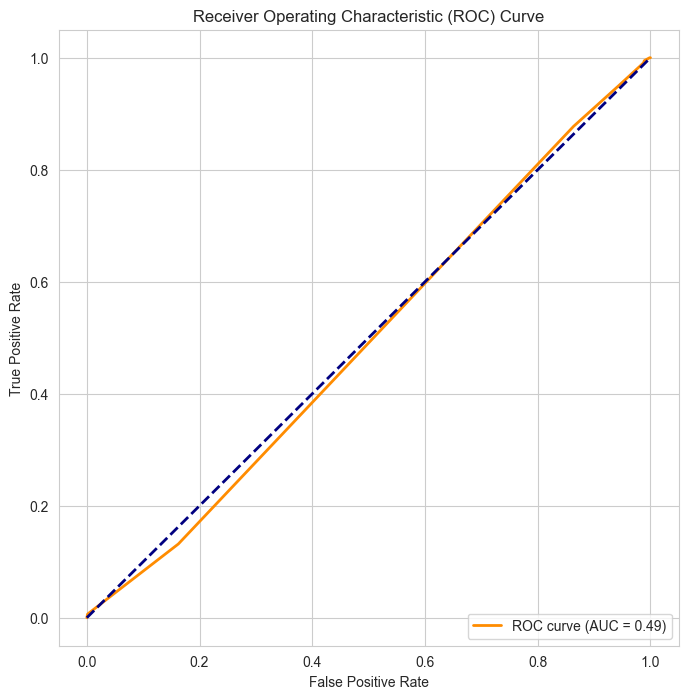

In [91]:
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

In [92]:
precision, recall, _ = precision_recall_curve(y_test, y_pred_proba_test)
average_precision = average_precision_score(y_test, y_pred_proba_test)

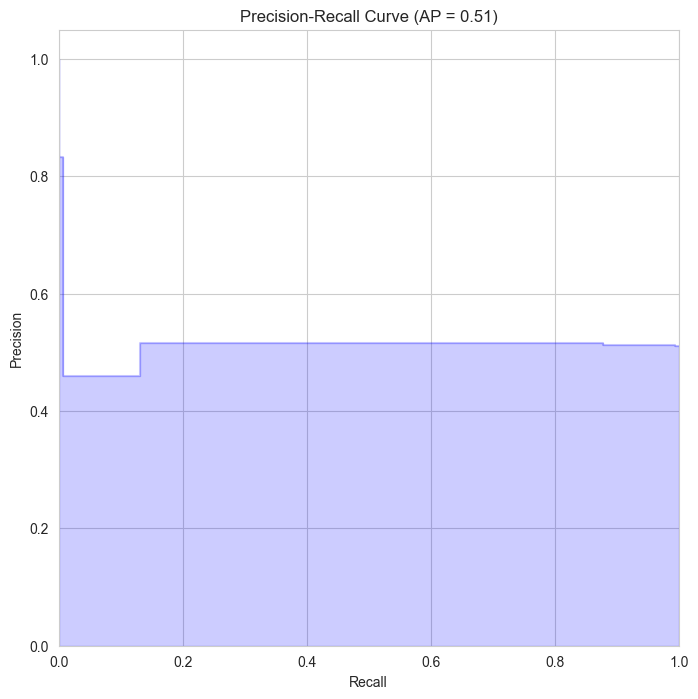

In [93]:
plt.figure(figsize=(8, 8))
plt.step(recall, precision, color='b', alpha=0.2, where='post')
plt.fill_between(recall, precision, step='post', alpha=0.2, color='b')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title('Precision-Recall Curve (AP = {:.2f})'.format(average_precision))
plt.show()

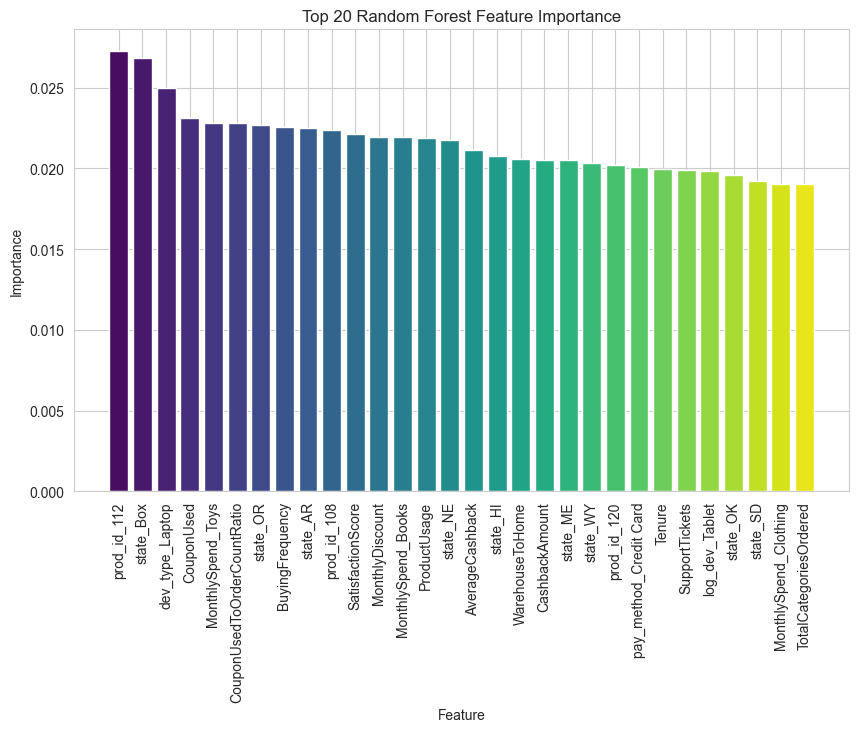

In [96]:
feature_importance = model.feature_importances_

feature_names = X.columns

top20_idx = feature_importance.argsort()[-30:][::-1]

top20_feature_importance = feature_importance[top20_idx]
top20_feature_names = feature_names[top20_idx]

colors = sns.color_palette("viridis", len(top20_feature_importance))

plt.figure(figsize=(10, 6))
plt.bar(range(len(top20_feature_importance)), top20_feature_importance, align="center", color=colors)
plt.xticks(range(len(top20_feature_importance)), top20_feature_names, rotation='vertical')
plt.xlabel("Feature")
plt.ylabel("Importance")
plt.title("Top 20 Random Forest Feature Importance")
plt.show()

## SVC

In [97]:
svc_model = SVC(random_state = 1)
svc_model.fit(X_train,y_train)
predict_y = svc_model.predict(X_test)
accuracy_svc = svc_model.score(X_test,y_test)
print("SVM accuracy is :",accuracy_svc)

SVM accuracy is : 0.5193333333333333


In [101]:
print(classification_report(y_test, predict_y))

              precision    recall  f1-score   support

       False       0.51      0.55      0.53       733
        True       0.53      0.49      0.51       767

    accuracy                           0.52      1500
   macro avg       0.52      0.52      0.52      1500
weighted avg       0.52      0.52      0.52      1500



## Extreme trees